# Notebook général : Assises de l'enseignement supérieur

Ce notebook a pour but de développer et utiliser des fonctions nécessaires à la resititution du questionnaire sur les assises de l'enseignement supérieur. 

Il y trois questionnaires, un pour chaque type de répondant:



[Url des questionnaires.](https://www.iledefrance.fr/chercheurs-enseignants-etudiants-votre-avis-nous-interesse)



**TO DO** : 

- Du jour de la semaine ?

- Remplacer certaines valeurs (trop longues)

- Changer les propriétés des nuages de mot

- Comparer les réponses aux questionnaires Enseignants / Etudiants (mêmes questions / différentes réponses)

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import numpy as np
import os
import re

import seaborn as sns

from textwrap import wrap
from wordcloud import WordCloud, STOPWORDS




import spacy.lang.fr
import spacy

global spacy_nlp
spacy_nlp = spacy.load('fr_core_news_sm')
import normalise

STOPWORDS = spacy.lang.fr.stop_words.STOP_WORDS

import string
#Lemmatization:
#tweet=spacy_nlp(tweet)
#tweet = ' '.join(word.lemma_ for word in tweet) 


from PIL import Image
from os import path
import os

import ast

C:\Users\adrie\Anaconda3\lib\site-packages\statsmodels\tools\_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm
C:\Users\adrie\Anaconda3\lib\site-packages\sklearn\base.py:306: UserWarning: Trying to unpickle estimator LabelPropagation from version 0.18 when using version 0.21.3. This might lead to breaking code or invalid results. Use at your own risk.
  UserWarning)


In [2]:
pd.set_option('display.max_columns', 50)
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_colwidth', 500)

## Imports contributions

Création d'un dictionnaire pour faciliter l'affichage :

In [3]:
questionnaires = {
    'chercheurs, enseignants-chercheurs et ingénieurs.xlsx':'Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs',
    'enseignants ou personnels encadrants des campus.xlsx':'Questionnaire à destination des enseignants ou personnels encadrants des campus',
    'étudiants.xlsx':'Questionnaire à destination des étudiants'
}

In [4]:
filenames = list(questionnaires.keys())
themes = list(questionnaires.values())

In [5]:
filepaths = [os.path.join('Data/',filename) for filename in filenames]

Définition de la colonne `Created`, de type `date`

In [6]:
col_date = ['Created']

In [7]:
df_list = [pd.read_excel(filepath, parse_dates=col_date) for filepath in filepaths]

Colonnes communes à tous les datasets (tous les thèmes):

Cela permettra d'extraire les questions de chaque thème, puisque les seules colonnes qui ne sont pas en commun à tous les thèmes sont les colonnes qui correspondent aux questions.

In [8]:
col_common = ['Created']

On affiche des informations générales sur les thèmes:

In [9]:
df_infos = pd.DataFrame({
     'Questionnaire': themes,
     'nombre de sondés': [df.shape[0] for df in df_list],
     'nombre de questions': [sum(~df.columns.isin(col_common)) for df in df_list]
    })
df_infos

,Questionnaire,nombre de sondés,nombre de questions
0,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",242,12
1,Questionnaire à destination des enseignants ou personnels encadrants des campus,37,22
2,Questionnaire à destination des étudiants,623,21


## Définition des questions

In [10]:
#Création d'un DataFrame général contenant les numéros de questions pour tous les questionnaires, les questions
#générales et les sous questions associées, correspondant aux colonnes dans le jeu de données.

df_def_questions=pd.DataFrame()

- `cq` = `closed question`
- `cmq` = `closed question without unique answer`
- `mtq` = `mixed-type question`
- `oq` = `open question`

### Chercheurs

In [11]:
themes[0]

'Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs'

In [12]:
df_list[0].columns

Index(['Created',
       'Avez-vous eu connaissance des dispositifs de la Région en faveur de la Recherche en Île-de-France ?',
       'Connaissez-vous les différents Domaines d’intérêt majeur de recherche financés par la Région Île-de-France ?',
       'Voici la liste des différents Domaines d’intérêt majeur de recherche : Math'innov, Matériaux anciens et patrimoniaux (MAP), Science et ingénierie en région Île-de-France pour les technologies quantiques (SIRTEQ), Islam en Île-de-France, Astrophysique et conditions d'apparition de la vie (ACAV+), Ruptures en sciences des solides poreux (Respore), Thérapie génique, Un monde, une seule santé (One Health), Empowering Life sCiences with Innovative Technologies – Technologies innovantes pour les sciences de la vie (ELICIT), Sciences du texte et connaissances nouvelles, dont la première pierre est le Projet de recherche sur l'attribution d'auteur (PRADA), Qualité de l'air, impacts sanitaires et innovations technologiques et politiques (QI²), 

In [13]:
df_def_temp=pd.DataFrame()

df_def_temp['questionnaire']=[themes[0]]
df_def_temp['numero questionnaire']=[0]
df_def_temp['numéro de la question']=[['Q' + str(i) for i in range(1,7)]]

df_def_temp=df_def_temp.explode('numéro de la question').reset_index(drop=True)

df_def_temp['titre de la question']=["Avez-vous eu connaissance des dispositifs de la Région en faveur\
                                     de la Recherche en Île-de-France ?", "Connaissez-vous les différents \
                                     Domaines d’intérêt majeur de recherche financés par la Région Île-de-France ?", 
                                    "Voici la liste des différents Domaines d’intérêt majeur de recherche : Math'innov, Matériaux anciens et patrimoniaux (MAP),\
                                     Science et ingénierie en région Île-de-France pour les technologies quantiques (SIRTEQ), Islam en Île-de-France, Astrophysique\
                                     et conditions d'apparition de la vie (ACAV+), Ruptures en sciences des solides poreux (Respore), Thérapie génique, Un monde, une\
                                     seule santé (One Health), Empowering Life sCiences with Innovative Technologies – Technologies innovantes pour les sciences de la vie (ELICIT),\
                                     Sciences du texte et connaissances nouvelles, dont la première pierre est le Projet de recherche sur l'attribution d'auteur (PRADA), Qualité de\
                                     l'air, impacts sanitaires et innovations technologiques et politiques (QI²), Longévité et vieillissement, Réseau francilien en sciences\
                                     informatiques (RFSI). Lequel ou lesquels vous paraissent nécessaire d’ajouter à cette liste ?", 
                                    "Comment évaluez-vous le ou les dispositifs que vous connaissez ?", 
                                    "Pour développer vos partenariats en matière de R&D avec des entreprises en\
                                    Ile-de-France, en particulier des PME/ETI, quels freins rencontrez-vous ?",
                                    "Avez-vous des idées sur les évolutions à apporter aux dispositifs d’intervention de la Région en matière de recherche ?"]



df_def_temp['sous question']=['Avez-vous eu connaissance des dispositifs de la Région en faveur de la Recherche en Île-de-France ?', 
'Connaissez-vous les différents Domaines d’intérêt majeur de recherche financés par la Région Île-de-France ?',
"Voici la liste des différents Domaines d’intérêt majeur de recherche : Math'innov, Matériaux anciens et \
patrimoniaux (MAP), Science et ingénierie en région Île-de-France pour les technologies quantiques (SIRTEQ), \
Islam en Île-de-France, Astrophysique et conditions d'apparition de la vie (ACAV+), Ruptures en sciences des \
solides poreux (Respore), Thérapie génique, Un monde, une seule santé (One Health), Empowering Life sCiences \
with Innovative Technologies – Technologies innovantes pour les sciences de la vie (ELICIT), Sciences du texte et \
connaissances nouvelles, dont la première pierre est le Projet de recherche sur l'attribution d'auteur (PRADA), \
Qualité de l'air, impacts sanitaires et innovations technologiques et politiques (QI²), Longévité et vieillissement, \
Réseau francilien en sciences informatiques (RFSI). \
Lequel ou lesquels vous paraissent nécessaire d’ajouter à cette liste ?", 
['Les DIM-domaines d’intérêt majeur de recherche',
       'SESAME (les équipements pour les laboratoires)',
       'Les Chaires d’excellence internationale Blaise Pascal',
       'Les bourses doctorales Paris Region PhD', 'SESAME filière PIA',
       'Les bourses postdoctorales du programme européen Paris Region fellowship COFUND',
       'Le dispositif ACCESS de soutien à la mobilité des étudiants et des chercheurs internationaux'],
'Pour développer vos partenariats en matière de R&D avec des entreprises en Ile-de-France, \
en particulier des PME/ETI, quels freins rencontrez-vous ?',                              
'[Boîte à idées] Avez-vous des idées sur les évolutions à apporter aux dispositifs d’intervention de la Région en matière de recherche ?']


#On ajoute un titre pour les visualisations (plus courts) : 
df_def_temp['sq_titre_viz'] =['Avez-vous eu connaissance des dispositifs de la Région en faveur de la Recherche en Île-de-France ?', 
'Connaissez-vous les différents Domaines d’intérêt majeur de recherche financés par la Région Île-de-France ?',
"Quel ou quels DIM vous paraissent nécessaire d’ajouter à la liste ?", 
['Les DIM-domaines d’intérêt majeur de recherche',
       'SESAME (les équipements pour les laboratoires)',
       'Les Chaires d’excellence internationale Blaise Pascal',
       'Les bourses doctorales Paris Region PhD', 'SESAME filière PIA',
       'Les bourses postdoctorales du programme européen Paris Region fellowship COFUND',
       'Le dispositif ACCESS de soutien à la mobilité des étudiants et des chercheurs internationaux'],
'Pour développer vos partenariats en matière de R&D avec des entreprises en Ile-de-France, \
en particulier des PME/ETI, quels freins rencontrez-vous ?',                              
'[Boîte à idées] Avez-vous des idées sur les évolutions à apporter aux dispositifs d’intervention de la Région en matière de recherche ?']




df_def_temp['type de la sous question'] = ['cmq', 'cq', 'oq', 'mixed_tq_insatisfaisant', 'multi_mixed_cq_autre', 'oq']


df_def_temp=df_def_temp.set_index(['questionnaire', 'numero questionnaire', 'numéro de la question',
                                  'titre de la question', 'type de la sous question']).apply(pd.Series.explode).reset_index()

In [14]:
df_def_questions=df_def_questions.append(df_def_temp, ignore_index=True)

### enseignants ou personnels encadrants des campus

In [15]:
themes[1]

'Questionnaire à destination des enseignants ou personnels encadrants des campus'

In [16]:
df_list[1].columns

Index(['Created',
       'Quels dispositifs de la Région en faveur des étudiants et de l’enseignement supérieur connaissez-vous ?',
       'L’aide à la mobilité internationale',
       'Les dispositifs de lutte contre la précarité des étudiants',
       'L’aide au mérite',
       'Le soutien au diplôme d’accès aux études universitaires (DAEU)',
       'Les cordées de la réussite', 'Le soutien aux Etudiants ambassadeurs',
       'Le soutien aux Etudiants entrepreneurs',
       'Le portail de l’orientation ORIANE.INFO',
       'Le dispositif ACCESS de soutien à la mobilité des étudiants et des chercheurs internationaux',
       'QIOZ',
       'I-pass contraception (site de sensibilisation et d’information sur la santé sexuelle)',
       'Trophées des EdTech',
       'Soutien aux Digitales académies ou campus connectés', 'Challenge IA',
       'Nouvelle aide à l’équipement numérique des étudiants boursiers',
       'Parmi les problématiques suivantes, pouvez-vous sélectionner les trois pl

In [17]:
df_def_temp=pd.DataFrame()

df_def_temp['questionnaire']=[themes[1]]
df_def_temp['numero questionnaire']=[1]
df_def_temp['numéro de la question']=[['Q' + str(i) for i in range(1,10)]]

df_def_temp=df_def_temp.explode('numéro de la question').reset_index(drop=True)

df_def_temp['titre de la question']=["Quels dispositifs de la Région en faveur des étudiants et de l’enseignement supérieur connaissez-vous ?", 
                                    "Comment évaluez-vous le ou les dispositifs que vous connaissez ?", 
                                    "La Région soutient la transition numérique de l’enseignement supérieur au moyen de plusieurs dispositifs. Comment évaluez-vous le ou les dispositifs que vous connaissez ?", 
                                    "Parmi les problématiques suivantes, pouvez-vous sélectionner les trois plus importantes selon vous ", 
                                    "[Boîte à idées] Sur ces trois priorités, avez-vous des idées ou exemples d’actions régionales qui pourraient apporter des améliorations ?", 
                                    "[Boîte à idées] Avez-vous des idées ou des exemples de services ou d’équipements pour renforcer significativement l’attractivité de votre campus ou de votre établissement ?", 
                                    "A l’approche de l’heure du bilan du CPER (contrat de plan Etat Région 2015-2020), vous diriez-vous satisfait ou non des projets retenus dans ce contrat ? Quelles orientations devraient privilégier l’Etat et la Région pour le prochain ?", 
                                    "Dans le cadre de la crise du Covid 19, les moyens mis en place ont-ils permis selon vous d’assurer la continuité des enseignements ?", 
                                   "[Boîte à idées] Si vous avez répondu non ou partiellement à la question précédente : quels seraient vos besoins supplémentaires ?"]



df_def_temp['sous question']=['Quels dispositifs de la Région en faveur des étudiants et de l’enseignement supérieur connaissez-vous ?',
                             ['L’aide à la mobilité internationale',
       'Les dispositifs de lutte contre la précarité des étudiants',
       'L’aide au mérite',
       'Le soutien au diplôme d’accès aux études universitaires (DAEU)',
       'Les cordées de la réussite', 'Le soutien aux Etudiants ambassadeurs',
       'Le soutien aux Etudiants entrepreneurs',
       'Le portail de l’orientation ORIANE.INFO',
       'Le dispositif ACCESS de soutien à la mobilité des étudiants et des chercheurs internationaux',
       'QIOZ',
       'I-pass contraception (site de sensibilisation et d’information sur la santé sexuelle)'], 
        ['Trophées des EdTech',
       'Soutien aux Digitales académies ou campus connectés', 'Challenge IA',
       'Nouvelle aide à l’équipement numérique des étudiants boursiers'], 
        'Parmi les problématiques suivantes, pouvez-vous sélectionner les trois plus importantes selon vous', 
        '[Boîte à idées] Sur ces trois priorités, avez-vous des idées ou exemples d’actions régionales qui pourraient apporter des améliorations ?',
       '[Boîte à idées] Avez-vous des idées ou des exemples de services ou d’équipements pour renforcer significativement l’attractivité de votre campus ou de votre établissement ?',
       'A l’approche de l’heure du bilan du CPER (contrat de plan Etat Région 2015-2020), vous diriez-vous satisfait ou non des projets retenus dans ce contrat ? Quelles orientations devraient privilégier l’Etat et la Région pour le prochain ?',
       'Dans le cadre de la crise du Covid 19, les moyens mis en place ont-ils permis selon vous d’assurer la continuité des enseignements ?',
       '[Boîte à idées] Si vous avez répondu non ou partiellement à la question précédente : quels seraient vos besoins supplémentaires ?']

df_def_temp['sq_titre_viz']=['Quels dispositifs de la Région en faveur des étudiants et de l’enseignement supérieur connaissez-vous ?',
                             ['L’aide à la mobilité internationale',
       'Les dispositifs de lutte contre la précarité des étudiants',
       'L’aide au mérite',
       'Le soutien au diplôme d’accès aux études universitaires (DAEU)',
       'Les cordées de la réussite', 'Le soutien aux Etudiants ambassadeurs',
       'Le soutien aux Etudiants entrepreneurs',
       'Le portail de l’orientation ORIANE.INFO',
       'Le dispositif ACCESS de soutien à la mobilité des étudiants et des chercheurs internationaux',
       'QIOZ',
       'I-pass contraception (site de sensibilisation et d’information sur la santé sexuelle)'], 
        ['Trophées des EdTech',
       'Soutien aux Digitales académies ou campus connectés', 'Challenge IA',
       'Nouvelle aide à l’équipement numérique des étudiants boursiers'], 
        'Parmi les problématiques suivantes, pouvez-vous sélectionner les trois plus importantes selon vous', 
        '[Boîte à idées] Sur ces trois priorités, avez-vous des idées ou exemples d’actions régionales qui pourraient apporter des améliorations ?',
       '[Boîte à idées] Avez-vous des idées ou des exemples de services ou d’équipements pour renforcer significativement l’attractivité de votre campus ou de votre établissement ?',
       'A l’approche de l’heure du bilan du CPER (contrat de plan Etat Région 2015-2020), vous diriez-vous satisfait ou non des projets retenus dans ce contrat ? Quelles orientations devraient privilégier l’Etat et la Région pour le prochain ?',
       'Dans le cadre de la crise du Covid 19, les moyens mis en place ont-ils permis selon vous d’assurer la continuité des enseignements ?',
       '[Boîte à idées] Si vous avez répondu non ou partiellement à la question précédente : quels seraient vos besoins supplémentaires ?']




df_def_temp['type de la sous question'] = ['cmq', 'mixed_tq_insatisfaisant', 'mixed_tq_insatisfaisant', "cmq", 'oq', 'oq', 'oq', 'cq', 'oq']


df_def_temp=df_def_temp.set_index(['questionnaire', 'numero questionnaire', 'numéro de la question',
                                  'titre de la question', 'type de la sous question']).apply(pd.Series.explode).reset_index()

In [18]:
df_def_temp

,questionnaire,numero questionnaire,numéro de la question,titre de la question,type de la sous question,sous question,sq_titre_viz
0,Questionnaire à destination des enseignants ou personnels encadrants des campus,1,Q1,Quels dispositifs de la Région en faveur des étudiants et de l’enseignement supérieur connaissez-vous ?,cmq,Quels dispositifs de la Région en faveur des étudiants et de l’enseignement supérieur connaissez-vous ?,Quels dispositifs de la Région en faveur des étudiants et de l’enseignement supérieur connaissez-vous ?
1,Questionnaire à destination des enseignants ou personnels encadrants des campus,1,Q2,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,L’aide à la mobilité internationale,L’aide à la mobilité internationale
2,Questionnaire à destination des enseignants ou personnels encadrants des campus,1,Q2,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,Les dispositifs de lutte contre la précarité des étudiants,Les dispositifs de lutte contre la précarité des étudiants
3,Questionnaire à destination des enseignants ou personnels encadrants des campus,1,Q2,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,L’aide au mérite,L’aide au mérite
4,Questionnaire à destination des enseignants ou personnels encadrants des campus,1,Q2,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,Le soutien au diplôme d’accès aux études universitaires (DAEU),Le soutien au diplôme d’accès aux études universitaires (DAEU)
5,Questionnaire à destination des enseignants ou personnels encadrants des campus,1,Q2,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,Les cordées de la réussite,Les cordées de la réussite
6,Questionnaire à destination des enseignants ou personnels encadrants des campus,1,Q2,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,Le soutien aux Etudiants ambassadeurs,Le soutien aux Etudiants ambassadeurs
7,Questionnaire à destination des enseignants ou personnels encadrants des campus,1,Q2,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,Le soutien aux Etudiants entrepreneurs,Le soutien aux Etudiants entrepreneurs
8,Questionnaire à destination des enseignants ou personnels encadrants des campus,1,Q2,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,Le portail de l’orientation ORIANE.INFO,Le portail de l’orientation ORIANE.INFO
9,Questionnaire à destination des enseignants ou personnels encadrants des campus,1,Q2,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,Le dispositif ACCESS de soutien à la mobilité des étudiants et des chercheurs internationaux,Le dispositif ACCESS de soutien à la mobilité des étudiants et des chercheurs internationaux


In [19]:
df_def_questions=df_def_questions.append(df_def_temp, ignore_index=True)

### Etudiants

In [20]:
themes[2]

'Questionnaire à destination des étudiants'

In [21]:
df_list[2].columns

Index(['Created',
       'Quels dispositifs de la Région en faveur des étudiants et de l’enseignement supérieur connaissez-vous ?',
       'L’aide à la mobilité internationale',
       'Les dispositifs de lutte contre la précarité des étudiants',
       'L’aide au mérite',
       'Le soutien au diplôme d’accès aux études universitaires (DAEU)',
       'Les cordées de la réussite', 'Le soutien aux Etudiants ambassadeurs',
       'Le soutien aux Etudiants entrepreneurs',
       'Le portail de l’orientation ORIANE.INFO',
       'Le dispositif ACCESS de soutien à la mobilité des étudiants et des chercheurs internationaux',
       'QIOZ',
       'I-pass contraception (site de sensibilisation et d’information sur la santé sexuelle)',
       'Trophées des EdTech',
       'Soutien aux Digitales académies ou campus connectés', 'Challenge IA',
       'Nouvelle aide à l’équipement numérique des étudiants boursiers',
       'Parmi les problématiques suivantes, pouvez-vous sélectionner les trois pl

In [22]:
df_def_temp=pd.DataFrame()

df_def_temp['questionnaire']=[themes[2]]
df_def_temp['numero questionnaire']=[2]
df_def_temp['numéro de la question']=[['Q' + str(i) for i in range(1,9)]]

df_def_temp=df_def_temp.explode('numéro de la question').reset_index(drop=True)

df_def_temp['titre de la question']=["Quels dispositifs de la Région en faveur des étudiants et de l’enseignement supérieur connaissez-vous ?", 
                                    "Comment évaluez-vous le ou les dispositifs que vous connaissez ?", 
                                    "La Région soutient la transition numérique de l’enseignement supérieur au moyen de plusieurs dispositifs. Comment évaluez-vous le ou les dispositifs que vous connaissez ?", 
                                    "Parmi les problématiques suivantes, pouvez-vous sélectionner les trois plus importantes selon vous ", 
                                    "[Boîte à idées] Sur ces trois priorités, avez-vous des idées ou exemples d’actions régionales qui pourraient apporter des améliorations ?", 
                                    "[Boîte à idées] Avez-vous des idées ou des exemples de services ou d’équipements pour renforcer significativement l’attractivité de votre campus ou de votre établissement ?", 
                                    "Dans le cadre de la crise du Covid 19, les moyens mis en place ont-ils permis selon vous, d’assurer la continuité des enseignements ?", 
                                    "[Boîte à idées] Si vous avez répondu non ou partiellement à la question précédente : quels seraient vos besoins supplémentaires ?"]



df_def_temp['sous question']=['Quels dispositifs de la Région en faveur des étudiants et de l’enseignement supérieur connaissez-vous ?', 
                             ['L’aide à la mobilité internationale',
       'Les dispositifs de lutte contre la précarité des étudiants',
       'L’aide au mérite',
       'Le soutien au diplôme d’accès aux études universitaires (DAEU)',
       'Les cordées de la réussite', 'Le soutien aux Etudiants ambassadeurs',
       'Le soutien aux Etudiants entrepreneurs',
       'Le portail de l’orientation ORIANE.INFO',
       'Le dispositif ACCESS de soutien à la mobilité des étudiants et des chercheurs internationaux',
       'QIOZ',
       'I-pass contraception (site de sensibilisation et d’information sur la santé sexuelle)'], 
                             ['Trophées des EdTech',
       'Soutien aux Digitales académies ou campus connectés', 'Challenge IA',
       'Nouvelle aide à l’équipement numérique des étudiants boursiers'], 
                             'Parmi les problématiques suivantes, pouvez-vous sélectionner les trois plus importantes selon vous',
       '[Boîte à idées] Sur ces trois priorités, avez-vous des idées ou exemples d’actions régionales qui pourraient apporter des améliorations ?',
       '[Boîte à idées] Avez-vous des idées ou des exemples de services ou d’équipements pour renforcer significativement l’attractivité de votre campus ou de votre établissement ?',
       'Dans le cadre de la crise du Covid 19, les moyens mis en place ont-ils permis selon vous, d’assurer la continuité des enseignements ?',
       '[Boîte à idées] Si vous avez répondu non ou partiellement à la question précédente : quels seraient vos besoins supplémentaires ?']


df_def_temp['sq_titre_viz']=['Quels dispositifs de la Région en faveur des étudiants et de l’enseignement supérieur connaissez-vous ?', 
                             ['L’aide à la mobilité internationale',
       'Les dispositifs de lutte contre la précarité des étudiants',
       'L’aide au mérite',
       'Le soutien au diplôme d’accès aux études universitaires (DAEU)',
       'Les cordées de la réussite', 'Le soutien aux Etudiants ambassadeurs',
       'Le soutien aux Etudiants entrepreneurs',
       'Le portail de l’orientation ORIANE.INFO',
       'Le dispositif ACCESS de soutien à la mobilité des étudiants et des chercheurs internationaux',
       'QIOZ',
       'I-pass contraception (site de sensibilisation et d’information sur la santé sexuelle)'], 
                             ['Trophées des EdTech',
       'Soutien aux Digitales académies ou campus connectés', 'Challenge IA',
       'Nouvelle aide à l’équipement numérique des étudiants boursiers'], 
                             'Parmi les problématiques suivantes, pouvez-vous sélectionner les trois plus importantes selon vous',
       '[Boîte à idées] Sur ces trois priorités, avez-vous des idées ou exemples d’actions régionales qui pourraient apporter des améliorations ?',
       '[Boîte à idées] Avez-vous des idées ou des exemples de services ou d’équipements pour renforcer significativement l’attractivité de votre campus ou de votre établissement ?',
       'Dans le cadre de la crise du Covid 19, les moyens mis en place ont-ils permis selon vous, d’assurer la continuité des enseignements ?',
       '[Boîte à idées] Si vous avez répondu non ou partiellement à la question précédente : quels seraient vos besoins supplémentaires ?']



df_def_temp['type de la sous question'] = ['cmq', 'mixed_tq_insatisfaisant', 'mixed_tq_insatisfaisant', 'cmq', 'oq', 'oq', 'cq', 'oq']


df_def_temp=df_def_temp.set_index(['questionnaire', 'numero questionnaire', 'numéro de la question',
                                  'titre de la question', 'type de la sous question']).apply(pd.Series.explode).reset_index()

In [23]:
df_def_temp

,questionnaire,numero questionnaire,numéro de la question,titre de la question,type de la sous question,sous question,sq_titre_viz
0,Questionnaire à destination des étudiants,2,Q1,Quels dispositifs de la Région en faveur des étudiants et de l’enseignement supérieur connaissez-vous ?,cmq,Quels dispositifs de la Région en faveur des étudiants et de l’enseignement supérieur connaissez-vous ?,Quels dispositifs de la Région en faveur des étudiants et de l’enseignement supérieur connaissez-vous ?
1,Questionnaire à destination des étudiants,2,Q2,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,L’aide à la mobilité internationale,L’aide à la mobilité internationale
2,Questionnaire à destination des étudiants,2,Q2,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,Les dispositifs de lutte contre la précarité des étudiants,Les dispositifs de lutte contre la précarité des étudiants
3,Questionnaire à destination des étudiants,2,Q2,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,L’aide au mérite,L’aide au mérite
4,Questionnaire à destination des étudiants,2,Q2,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,Le soutien au diplôme d’accès aux études universitaires (DAEU),Le soutien au diplôme d’accès aux études universitaires (DAEU)
5,Questionnaire à destination des étudiants,2,Q2,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,Les cordées de la réussite,Les cordées de la réussite
6,Questionnaire à destination des étudiants,2,Q2,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,Le soutien aux Etudiants ambassadeurs,Le soutien aux Etudiants ambassadeurs
7,Questionnaire à destination des étudiants,2,Q2,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,Le soutien aux Etudiants entrepreneurs,Le soutien aux Etudiants entrepreneurs
8,Questionnaire à destination des étudiants,2,Q2,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,Le portail de l’orientation ORIANE.INFO,Le portail de l’orientation ORIANE.INFO
9,Questionnaire à destination des étudiants,2,Q2,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,Le dispositif ACCESS de soutien à la mobilité des étudiants et des chercheurs internationaux,Le dispositif ACCESS de soutien à la mobilité des étudiants et des chercheurs internationaux


In [24]:
df_def_questions=df_def_questions.append(df_def_temp, ignore_index=True)

### Global

In [25]:
df_def_questions.head(2)

,questionnaire,numero questionnaire,numéro de la question,titre de la question,type de la sous question,sous question,sq_titre_viz
0,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q1,Avez-vous eu connaissance des dispositifs de la Région en faveur de la Recherche en Île-de-France ?,cmq,Avez-vous eu connaissance des dispositifs de la Région en faveur de la Recherche en Île-de-France ?,Avez-vous eu connaissance des dispositifs de la Région en faveur de la Recherche en Île-de-France ?
1,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q2,Connaissez-vous les différents Domaines d’intérêt majeur de recherche financés par la Région Île-de-France ?,cq,Connaissez-vous les différents Domaines d’intérêt majeur de recherche financés par la Région Île-de-France ?,Connaissez-vous les différents Domaines d’intérêt majeur de recherche financés par la Région Île-de-France ?


#### Saving

In [29]:
#df_def_questions.to_csv('Data/utilities/df_def_questions.csv', index=False)

## Définition des réponses

In [26]:
def get_reponses(df_list, n_questionnaire, col_name):
    liste_reponses=df_list[n_questionnaire][col_name].unique()
    return liste_reponses

In [27]:
df_reponses=df_def_questions.copy()

In [28]:
df_reponses['liste_reponses_raw'] = df_reponses.apply(lambda row:\
get_reponses(df_list, row['numero questionnaire'], row['sous question']), axis=1)

In [29]:
df_reponses

,questionnaire,numero questionnaire,numéro de la question,titre de la question,type de la sous question,sous question,sq_titre_viz,liste_reponses_raw
0,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q1,Avez-vous eu connaissance des dispositifs de la Région en faveur de la Recherche en Île-de-France ?,cmq,Avez-vous eu connaissance des dispositifs de la Région en faveur de la Recherche en Île-de-France ?,Avez-vous eu connaissance des dispositifs de la Région en faveur de la Recherche en Île-de-France ?,"[Les DIM-domaines d’intérêt majeur de recherche (13 réseaux thématiques de laboratoires pour lesquels la Région finance des emplois scientifiques et des équipements sur appels à projets en leur sein);SESAME (dispositif de financement d’équipements mi-lourds pour les laboratoires), Les DIM-domaines d’intérêt majeur de recherche (13 réseaux thématiques de laboratoires pour lesquels la Région finance des emplois scientifiques et des équipements sur appels à projets en leur sein);SESAME (disposi..."
1,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q2,Connaissez-vous les différents Domaines d’intérêt majeur de recherche financés par la Région Île-de-France ?,cq,Connaissez-vous les différents Domaines d’intérêt majeur de recherche financés par la Région Île-de-France ?,Connaissez-vous les différents Domaines d’intérêt majeur de recherche financés par la Région Île-de-France ?,"[non, oui, nan]"
2,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q3,"Voici la liste des différents Domaines d’intérêt majeur de recherche : Math'innov, Matériaux anciens et patrimoniaux (MAP), Science et ingénierie en région Île-de-France pour les technologies quantiques (SIRTEQ), Islam en Île-de-France, Astrophysique et conditions d'apparition de la vie (ACAV+), Ruptures en sciences des solides poreux (Respore), Thérapie génique, Un monde, une seule sa...",oq,"Voici la liste des différents Domaines d’intérêt majeur de recherche : Math'innov, Matériaux anciens et patrimoniaux (MAP), Science et ingénierie en région Île-de-France pour les technologies quantiques (SIRTEQ), Islam en Île-de-France, Astrophysique et conditions d'apparition de la vie (ACAV+), Ruptures en sciences des solides poreux (Respore), Thérapie génique, Un monde, une seule santé (One Health), Empowering Life sCiences with Innovative Technologies – Technologies innovantes pour les s...",Quel ou quels DIM vous paraissent nécessaire d’ajouter à la liste ?,"[Un sur l'art\nun sur la musique\nun sur la littérature\nun sur l'histoire\nun sur la psychologie\nun libre pour tout à ce qu'on a pas pensé, Bio production \nVaccinologie, nan, Qualité de vie en ville et transition écologique, maladies infectieuses\nmaladies chroniques\nélargie le DIM thérapie génique aux thérapies innovantes\nles 1000 premiers jours -> La période de la conception aux deux premières années de la vie après la naissance sont déterminantes pour le développement de l’enfant et ..."
3,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q4,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,Les DIM-domaines d’intérêt majeur de recherche,Les DIM-domaines d’intérêt majeur de recherche,"[On donne davantage aux projets scientifiques ou qui allient recherche et création d'entreprise, plutôt satisfaisant, Concentré sur les sciences dures, nan, En fait, mon avis est ""plutot satisfaisant"", mais cela ne me permet pas d'ajouter une commentaire. Le budget des DIM et leur fonctionnement sont très satisfaisant. On pourrait améliorer le calendrier des budget afin de mieux coller à l'agenda des labos (pour les theses et post-doc) mais dans l'ensemble ca va. Ce qui n'est pas satisfaisan..."
4,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q4,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,S

In [30]:
df_reponses[df_reponses['type de la sous question']=='cmq']

,questionnaire,numero questionnaire,numéro de la question,titre de la question,type de la sous question,sous question,sq_titre_viz,liste_reponses_raw
0,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q1,Avez-vous eu connaissance des dispositifs de la Région en faveur de la Recherche en Île-de-France ?,cmq,Avez-vous eu connaissance des dispositifs de la Région en faveur de la Recherche en Île-de-France ?,Avez-vous eu connaissance des dispositifs de la Région en faveur de la Recherche en Île-de-France ?,"[Les DIM-domaines d’intérêt majeur de recherche (13 réseaux thématiques de laboratoires pour lesquels la Région finance des emplois scientifiques et des équipements sur appels à projets en leur sein);SESAME (dispositif de financement d’équipements mi-lourds pour les laboratoires), Les DIM-domaines d’intérêt majeur de recherche (13 réseaux thématiques de laboratoires pour lesquels la Région finance des emplois scientifiques et des équipements sur appels à projets en leur sein);SESAME (disposi..."
12,Questionnaire à destination des enseignants ou personnels encadrants des campus,1,Q1,Quels dispositifs de la Région en faveur des étudiants et de l’enseignement supérieur connaissez-vous ?,cmq,Quels dispositifs de la Région en faveur des étudiants et de l’enseignement supérieur connaissez-vous ?,Quels dispositifs de la Région en faveur des étudiants et de l’enseignement supérieur connaissez-vous ?,"[L’aide à la mobilité internationale (financement de bourses de mobilité à l’étranger pour les étudiants de tous niveaux) ;Le soutien aux Etudiants entrepreneurs (PEPITE START’UP – dispositif d’aides directe et indirecte aux étudiants entrepreneurs, notamment leur accueil à Station F), Les cordées de la réussite (dispositif visant à favoriser l’émergence de parcours d’excellence dans l’enseignement supérieur pour tous les lycéens), L’aide à la mobilité internationale (financement de bourses ..."
28,Questionnaire à destination des enseignants ou personnels encadrants des campus,1,Q4,"Parmi les problématiques suivantes, pouvez-vous sélectionner les trois plus importantes selon vous",cmq,"Parmi les problématiques suivantes, pouvez-vous sélectionner les trois plus importantes selon vous","Parmi les problématiques suivantes, pouvez-vous sélectionner les trois plus importantes selon vous","[restauration;numérique;aides sociales, stage et insertion professionnelles, logement;numérique;stage et insertion professionnelles, logement;numérique;aides sociales, logement;restauration;vie de campus, logement;restauration, logement;santé;aides sociales, orientation;stage et insertion professionnelles, logement;restauration;santé, numérique;vie de campus;transport, logement;vie de campus;transport, logement;transport;aides sociales, logement;transport;stage et insertion professionnelles,..."
34,Questionnaire à destination des étudiants,2,Q1,Quels dispositifs de la Région en faveur des étudiants et de l’enseignement supérieur connaissez-vous ?,cmq,Quels dispositifs de la Région en faveur des étudiants et de l’enseignement supérieur connaissez-vous ?,Quels dispositifs de la Région en faveur des étudiants et de l’enseignement supérieur connaissez-vous ?,"[L’aide à la mobilité internationale (financement de bourses de mobilité à l’étranger pour les étudiants de tous niveaux) ;L’aide au mérite (financement d’une bourse aux bacheliers méritants pour accompagner le démarrage de leurs études), Le portail de l’orientation ORIANE.INFO (portail d’information sur les métiers, les parcours et les formations en IDF), L’aide à la mobilité internationale (financement de bourses de mobilité à l’étranger pour les étudiants de tous niveaux) ;Le soutien aux ..."
50,Questionnaire à destination des étudiants,2,Q4,"Parmi les problématiques suivantes, pouvez-vous sélectionner les trois plus importantes selon vous",cmq,"Parmi les problématiques suivantes, pouvez-vous sélectionner les trois plus importantes selon vous","Parmi les problématiques s

## Restitution

### Dates et heures des réponses

In [31]:
from datetime import datetime

In [32]:
def date_reponses(df_list, themes):
    
    """
    Est-il utile d'avoir un histogramme en fonction de l'heure ???
    Du mois ?
    De la semaine ?
    
    
    Stacked ???
    https://stackoverflow.com/questions/50319614/count-plot-with-stacked-bars-per-hue/50319805
    """
    
    df_temp=pd.DataFrame()
    df_temp['theme']=themes
    
    df_temp['Created']=[df['Created'].apply(lambda x: x.strftime('%d-%m-%y')) for df in df_list]
    df_temp=df_temp.explode('Created').reset_index(drop=True)

    order_list_dates=sorted([datetime.strptime(dt, "%d-%m-%y") for dt in df_temp['Created'].unique()])
    order_list_dates=[d.strftime('%d-%m-%y') for d in order_list_dates]
    
    plt.figure(figsize=(15,6))
    plt.title('Dates des réponses')
    sns.countplot(x='Created', hue = 'theme', data=df_temp, order=order_list_dates)
    plt.xticks(rotation=45)
    plt.xlabel('Date')
    plt.ylabel('Nombre de réponses')
    plt.savefig("Rendu_final/Images/Dates_Reponses.svg")
    plt.show()

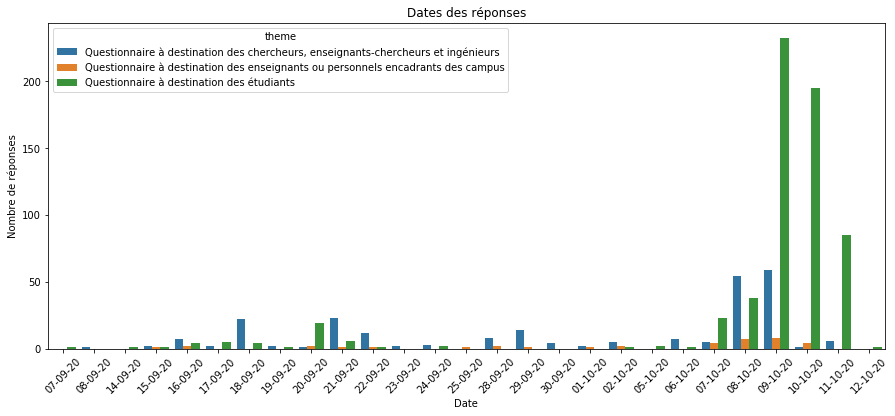

In [33]:
date_reponses(df_list, themes)

In [34]:
def heure_reponses(df_lits, themes):
        
    """
    Est-il utile d'avoir un histogramme en fonction de l'heure ???
    Du mois ?
    De la semaine ?
    
    
    Stacked ???
    https://stackoverflow.com/questions/50319614/count-plot-with-stacked-bars-per-hue/50319805
    """
    
    df_temp=pd.DataFrame()
    df_temp['theme']=themes
    
    df_temp['Created']=[df['Created'].apply(lambda x: x.strftime('%H')) for df in df_list]
    df_temp=df_temp.explode('Created').reset_index(drop=True)

    order_list_dates=sorted([datetime.strptime(dt, "%H") for dt in df_temp['Created'].unique()])
    order_list_dates=[d.strftime('%H') for d in order_list_dates]
    
    plt.figure(figsize=(15,6))
    plt.title('Heures des réponses')
    sns.countplot(x='Created', hue = 'theme', data=df_temp, order=order_list_dates)
    plt.xticks(rotation=45)
    plt.xlabel('Heure')
    plt.ylabel('Nombre de réponses')
    plt.savefig("Rendu_final/Images/Heures_Reponses.svg")
    plt.show()

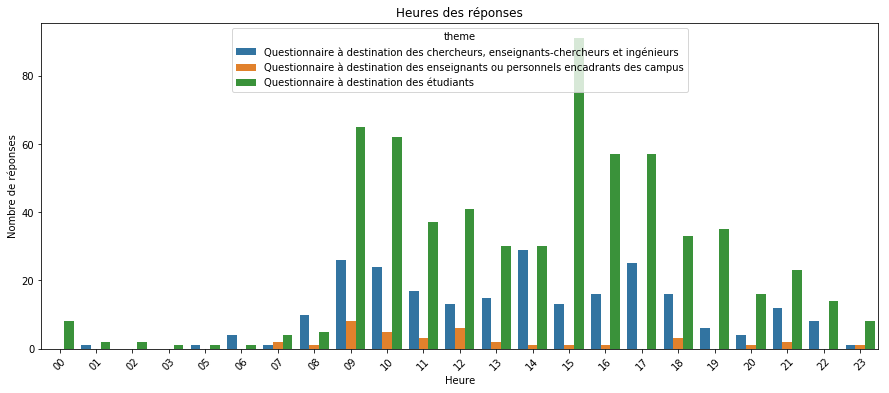

In [35]:
heure_reponses(df_list, themes)

### Statistiques sur les réponses

On peut vouloir calculer plusieurs choses :
- Le nombre de lignes, c'est-à-dire le nombre de répondants ayant eu accès à la question considérée
- Le nombre de réponse non-nulle à cette question
- Le nombre de réponses uniques à cette question

On peut alors aussi calculer les taux associées : 
- taux de réponses non nulles (taux de réponse)
- taux de réponses uniques


In [36]:
def stats_themes_questions(df_list, n_questionnaire, col_name):
    nombre_row=df_list[n_questionnaire][col_name].shape[0]
    nombre_non_null=df_list[n_questionnaire][col_name].notna().sum()
    nombre_unique=df_list[n_questionnaire][col_name].dropna().nunique()
    
    return pd.Series([nombre_row, nombre_non_null, nombre_unique])

In [37]:
df_stats=df_def_questions.copy()

In [38]:
df_stats[['nrow', 'n_n_null', 'nunique']] = df_stats.apply(lambda row: stats_themes_questions(df_list, row['numero questionnaire'], row['sous question']), axis=1)

In [39]:
df_stats['non_nul_rate']=(df_stats['n_n_null']/df_stats['nrow'])*100
df_stats['unique_rate']=(df_stats['nunique']/df_stats['nrow'])*100

In [40]:
df_stats

,questionnaire,numero questionnaire,numéro de la question,titre de la question,type de la sous question,sous question,sq_titre_viz,nrow,n_n_null,nunique,non_nul_rate,unique_rate
0,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q1,Avez-vous eu connaissance des dispositifs de la Région en faveur de la Recherche en Île-de-France ?,cmq,Avez-vous eu connaissance des dispositifs de la Région en faveur de la Recherche en Île-de-France ?,Avez-vous eu connaissance des dispositifs de la Région en faveur de la Recherche en Île-de-France ?,242,242,51,100.000000,21.074380
1,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q2,Connaissez-vous les différents Domaines d’intérêt majeur de recherche financés par la Région Île-de-France ?,cq,Connaissez-vous les différents Domaines d’intérêt majeur de recherche financés par la Région Île-de-France ?,Connaissez-vous les différents Domaines d’intérêt majeur de recherche financés par la Région Île-de-France ?,242,239,2,98.760331,0.826446
2,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q3,"Voici la liste des différents Domaines d’intérêt majeur de recherche : Math'innov, Matériaux anciens et patrimoniaux (MAP), Science et ingénierie en région Île-de-France pour les technologies quantiques (SIRTEQ), Islam en Île-de-France, Astrophysique et conditions d'apparition de la vie (ACAV+), Ruptures en sciences des solides poreux (Respore), Thérapie génique, Un monde, une seule sa...",oq,"Voici la liste des différents Domaines d’intérêt majeur de recherche : Math'innov, Matériaux anciens et patrimoniaux (MAP), Science et ingénierie en région Île-de-France pour les technologies quantiques (SIRTEQ), Islam en Île-de-France, Astrophysique et conditions d'apparition de la vie (ACAV+), Ruptures en sciences des solides poreux (Respore), Thérapie génique, Un monde, une seule santé (One Health), Empowering Life sCiences with Innovative Technologies – Technologies innovantes pour les s...",Quel ou quels DIM vous paraissent nécessaire d’ajouter à la liste ?,242,156,154,64.462810,63.636364
3,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q4,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,Les DIM-domaines d’intérêt majeur de recherche,Les DIM-domaines d’intérêt majeur de recherche,242,152,50,62.809917,20.661157
4,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q4,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,SESAME (les équipements pour les laboratoires),SESAME (les équipements pour les laboratoires),242,113,22,46.694215,9.090909
5,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q4,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,Les Chaires d’excellence internationale Blaise Pascal,Les Chaires d’excellence internationale Blaise Pascal,242,90,26,37.190083,10.743802
6,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q4,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,Les bourses doctorales Paris Region PhD,Les bourses doctorales Paris Region PhD,242,94,36,38.842975,14.876033
7,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q4,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,SESAME filière PIA,SESAME filière PIA,242,50,18,20.661157,7.438017
8,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q4,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,Les bourses postdoctorales du programme européen Paris Region fellowship COFUND,Les bourses postdoctorales du programme européen Paris Region fellowship COFUND,242,74,22,30.578512,9.090909
9,"Questionnaire à destination 

In [41]:
df_stats.groupby('questionnaire')['non_nul_rate'].mean()

questionnaire
Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs    54.511019
Questionnaire à destination des enseignants ou personnels encadrants des campus     39.434889
Questionnaire à destination des étudiants                                           34.762669
Name: non_nul_rate, dtype: float64

In [42]:
df_stats.groupby(['questionnaire', 'numéro de la question'])['non_nul_rate'].mean()

questionnaire                                                                     numéro de la question
Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs  Q1                       100.000000
                                                                                  Q2                        98.760331
                                                                                  Q3                        64.462810
                                                                                  Q4                        37.072019
                                                                                  Q5                        88.842975
                                                                                  Q6                        42.561983
Questionnaire à destination des enseignants ou personnels encadrants des campus   Q1                       100.000000
                                                                      

In [43]:
df_def_questions

,questionnaire,numero questionnaire,numéro de la question,titre de la question,type de la sous question,sous question,sq_titre_viz
0,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q1,Avez-vous eu connaissance des dispositifs de la Région en faveur de la Recherche en Île-de-France ?,cmq,Avez-vous eu connaissance des dispositifs de la Région en faveur de la Recherche en Île-de-France ?,Avez-vous eu connaissance des dispositifs de la Région en faveur de la Recherche en Île-de-France ?
1,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q2,Connaissez-vous les différents Domaines d’intérêt majeur de recherche financés par la Région Île-de-France ?,cq,Connaissez-vous les différents Domaines d’intérêt majeur de recherche financés par la Région Île-de-France ?,Connaissez-vous les différents Domaines d’intérêt majeur de recherche financés par la Région Île-de-France ?
2,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q3,"Voici la liste des différents Domaines d’intérêt majeur de recherche : Math'innov, Matériaux anciens et patrimoniaux (MAP), Science et ingénierie en région Île-de-France pour les technologies quantiques (SIRTEQ), Islam en Île-de-France, Astrophysique et conditions d'apparition de la vie (ACAV+), Ruptures en sciences des solides poreux (Respore), Thérapie génique, Un monde, une seule sa...",oq,"Voici la liste des différents Domaines d’intérêt majeur de recherche : Math'innov, Matériaux anciens et patrimoniaux (MAP), Science et ingénierie en région Île-de-France pour les technologies quantiques (SIRTEQ), Islam en Île-de-France, Astrophysique et conditions d'apparition de la vie (ACAV+), Ruptures en sciences des solides poreux (Respore), Thérapie génique, Un monde, une seule santé (One Health), Empowering Life sCiences with Innovative Technologies – Technologies innovantes pour les s...",Quel ou quels DIM vous paraissent nécessaire d’ajouter à la liste ?
3,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q4,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,Les DIM-domaines d’intérêt majeur de recherche,Les DIM-domaines d’intérêt majeur de recherche
4,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q4,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,SESAME (les équipements pour les laboratoires),SESAME (les équipements pour les laboratoires)
5,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q4,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,Les Chaires d’excellence internationale Blaise Pascal,Les Chaires d’excellence internationale Blaise Pascal
6,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q4,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,Les bourses doctorales Paris Region PhD,Les bourses doctorales Paris Region PhD
7,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q4,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,SESAME filière PIA,SESAME filière PIA
8,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q4,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,Les bourses postdoctorales du programme européen Paris Region fellowship COFUND,Les bourses postdoctorales du programme européen Paris Region fellowship COFUND
9,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q4,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,Le dispositif ACCESS de soutien à la mobilité des étudiants et des chercheurs internationaux,Le dispositif ACCESS de soutien à la mobilité des étudiants et des chercheurs 

### Résultats des questions  - Général

Dans cette partie, on présente les résultats généraux concernant les réponses aux questions

C:\Users\adrie\AppData\Roaming\Python\Python37\site-packages\matplotlib\pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
C:\Users\adrie\AppData\Roaming\Python\Python37\site-packages\matplotlib\pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
C:\Users\adrie\AppData\Roaming\Python\Python37\site-packages\matplotlib\pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) 

C:\Users\adrie\AppData\Roaming\Python\Python37\site-packages\matplotlib\pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
C:\Users\adrie\AppData\Roaming\Python\Python37\site-packages\matplotlib\pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
C:\Users\adrie\AppData\Roaming\Python\Python37\site-packages\matplotlib\pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) 

Wall time: 23min 30s


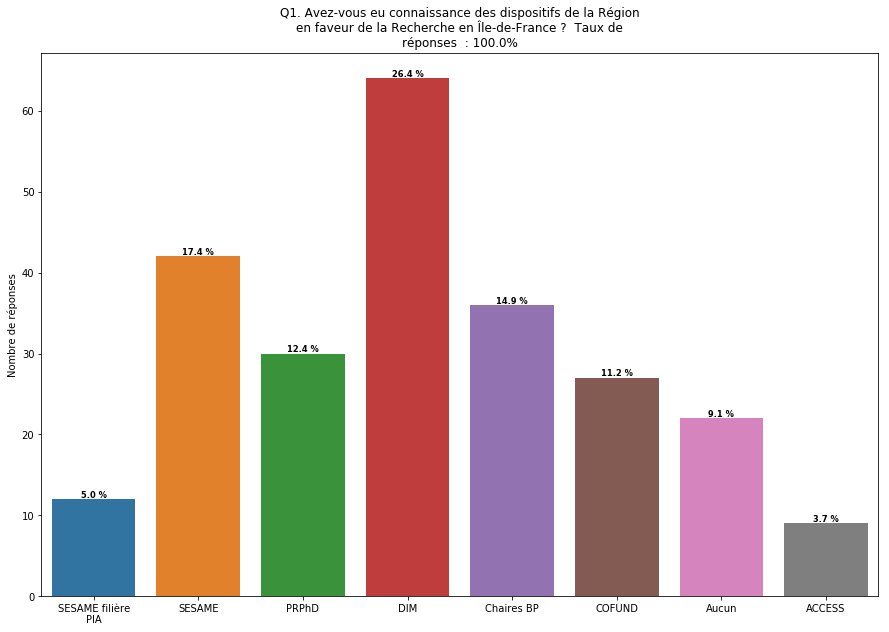

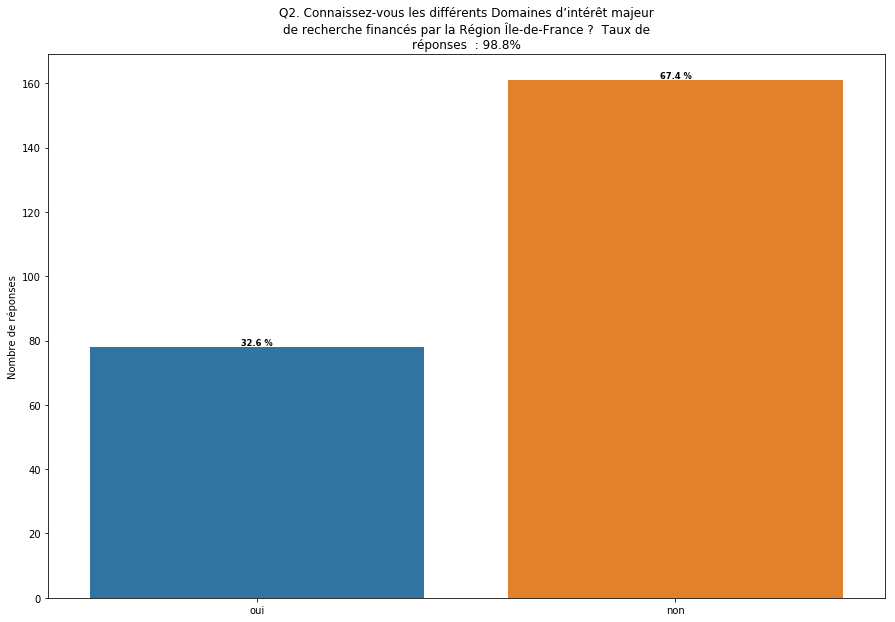

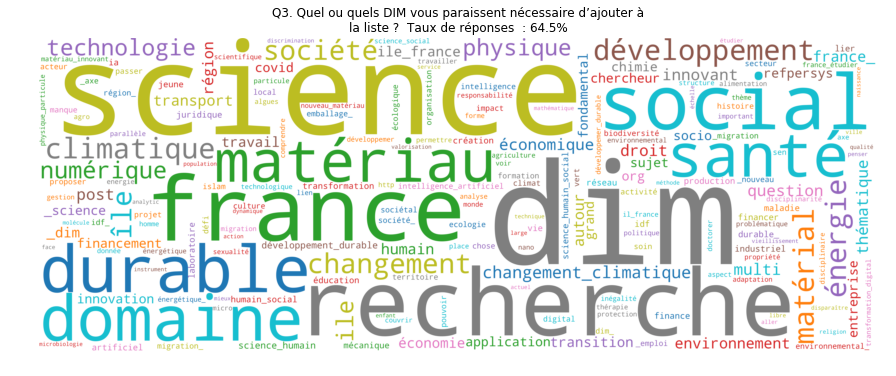

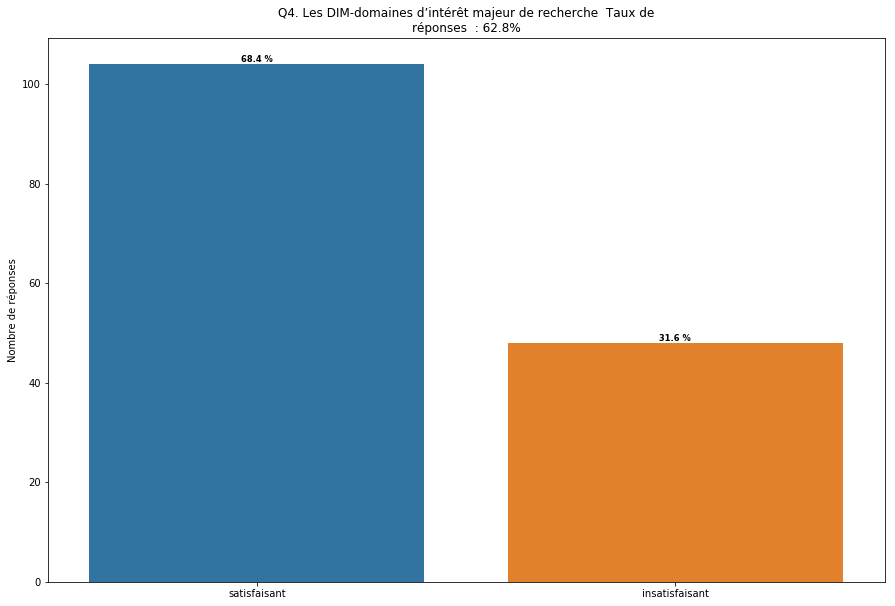

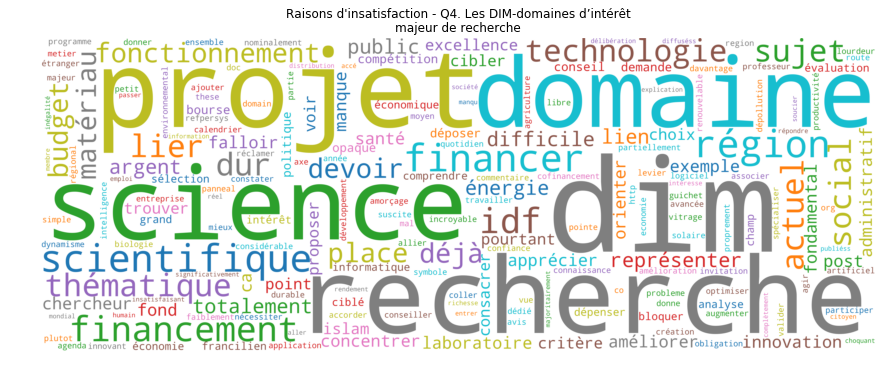

...

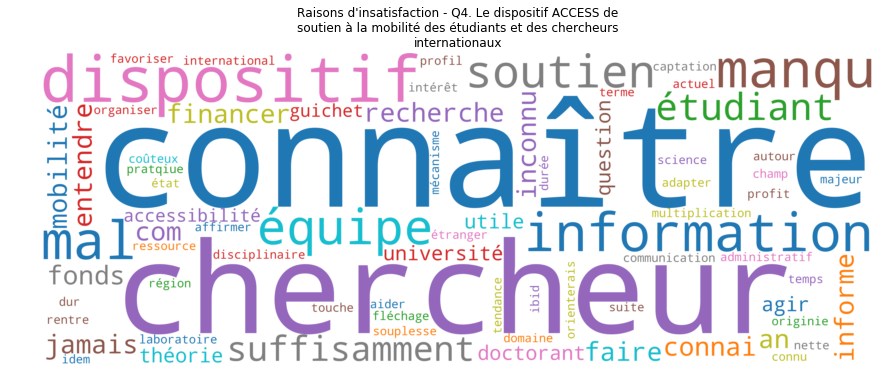

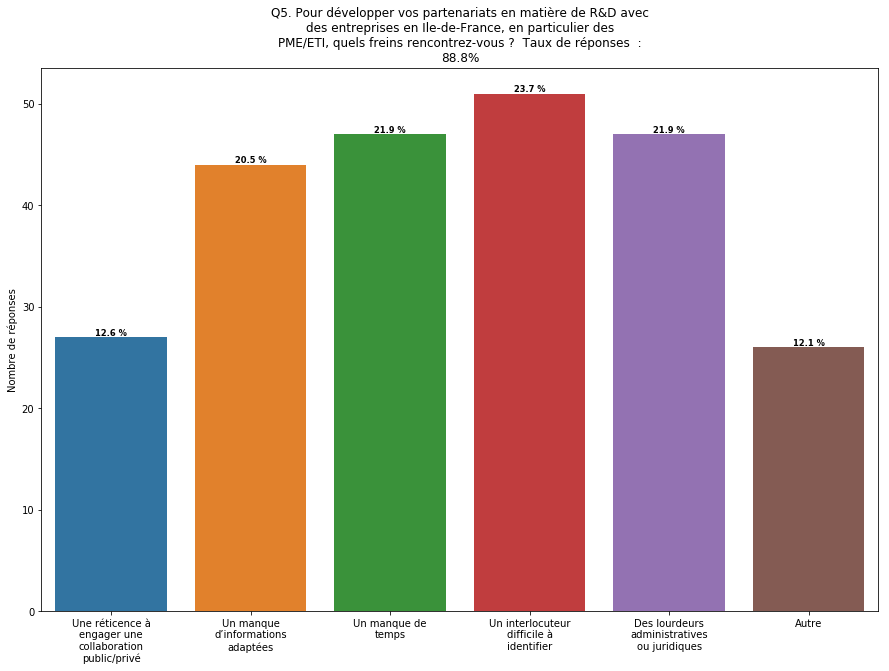

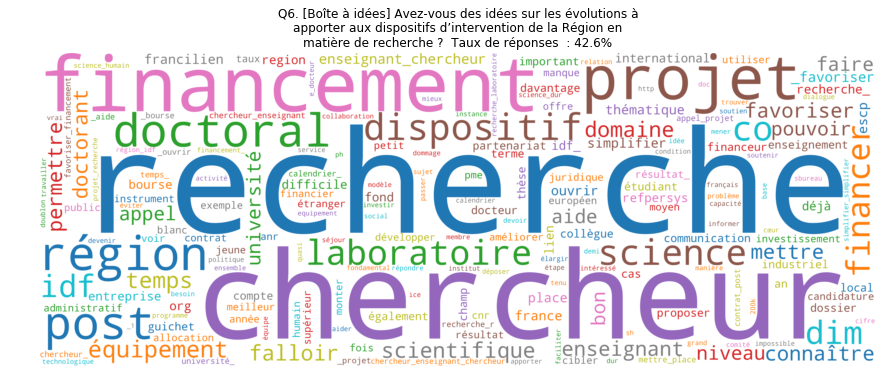

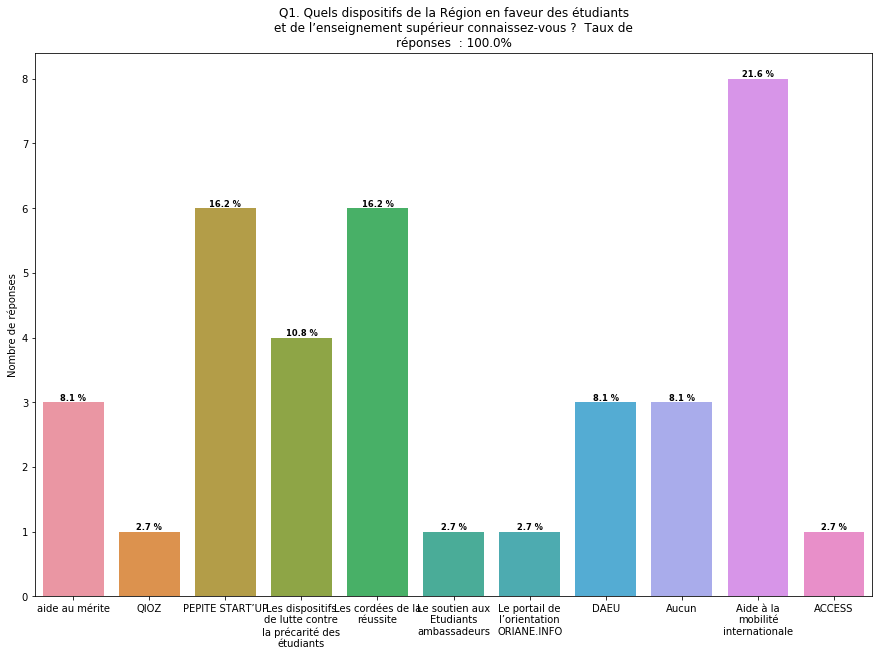

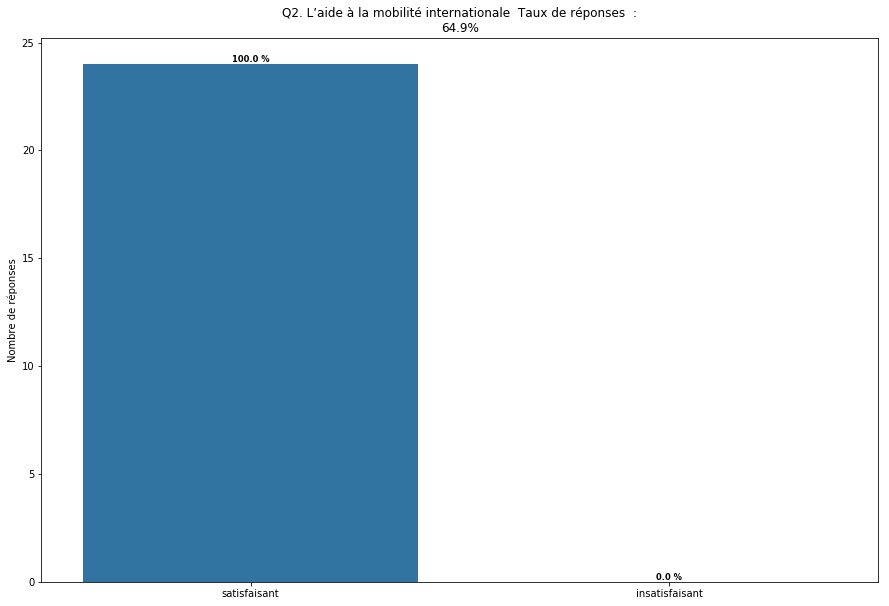

<Figure size 1080x720 with 0 Axes>

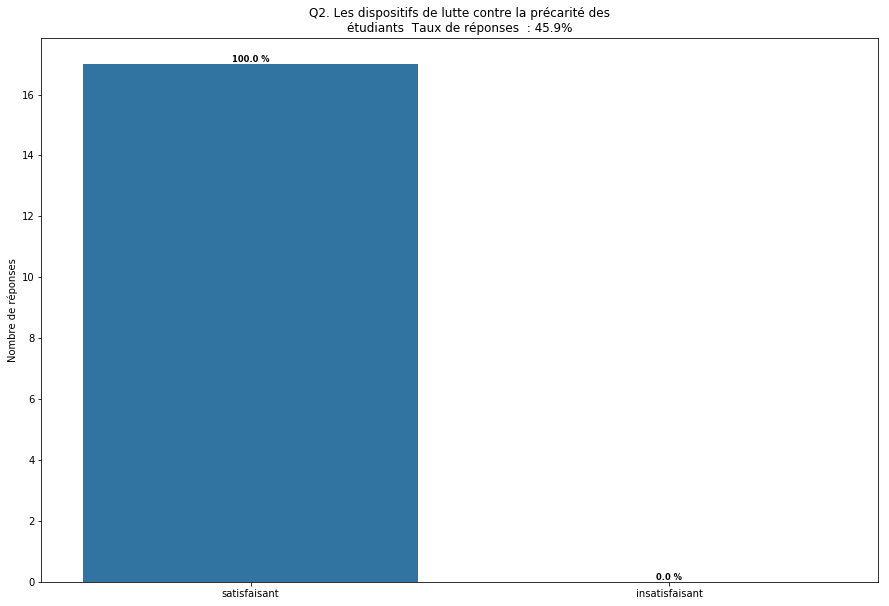

<Figure size 1080x720 with 0 Axes>

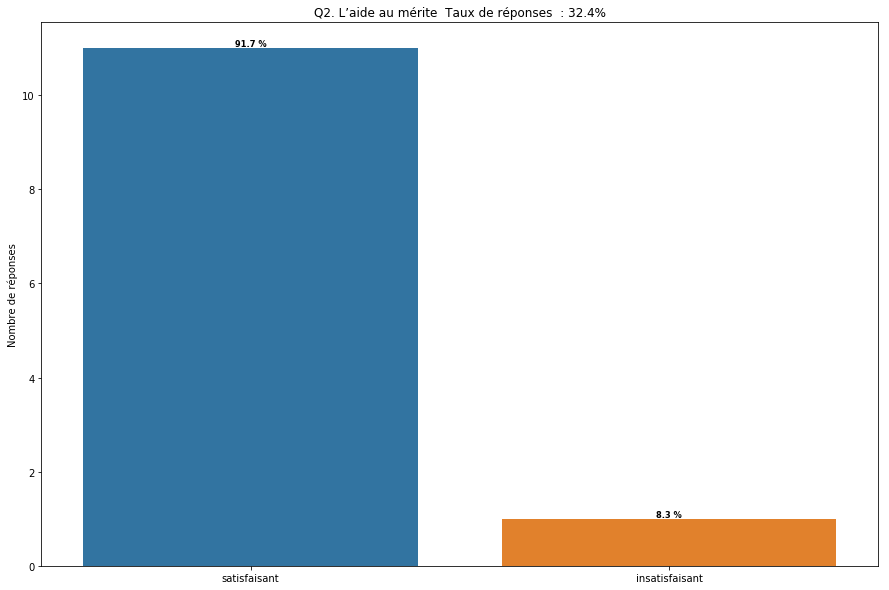

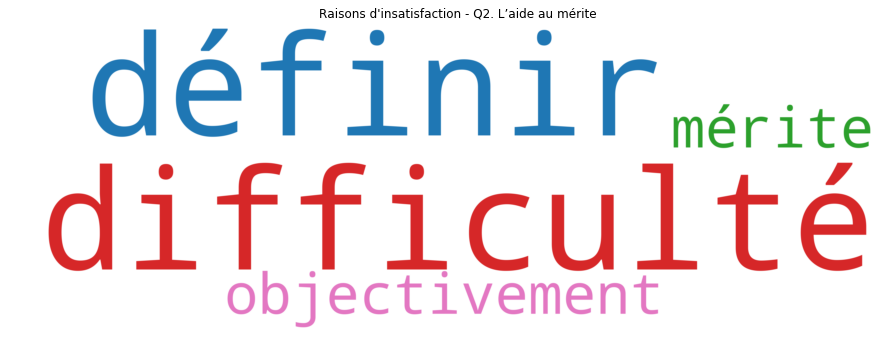

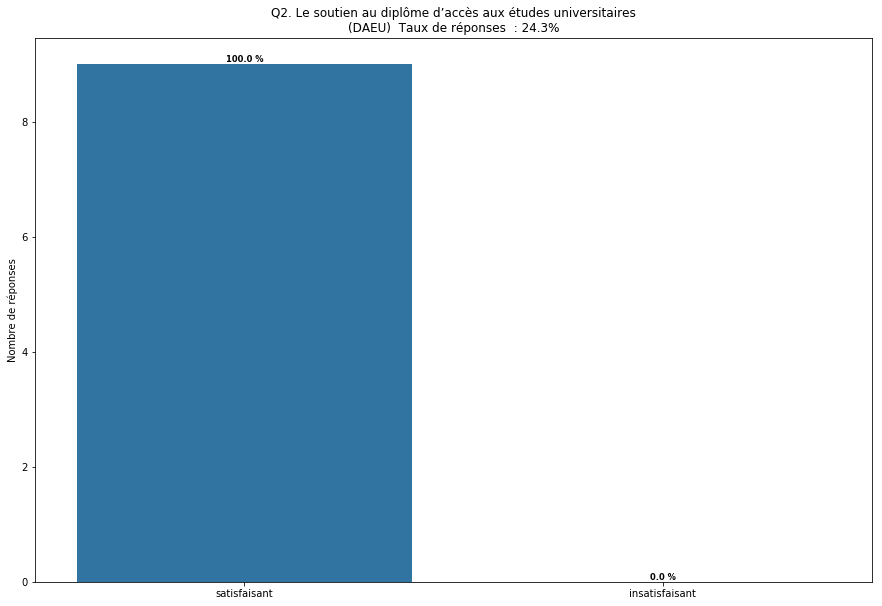

<Figure size 1080x720 with 0 Axes>

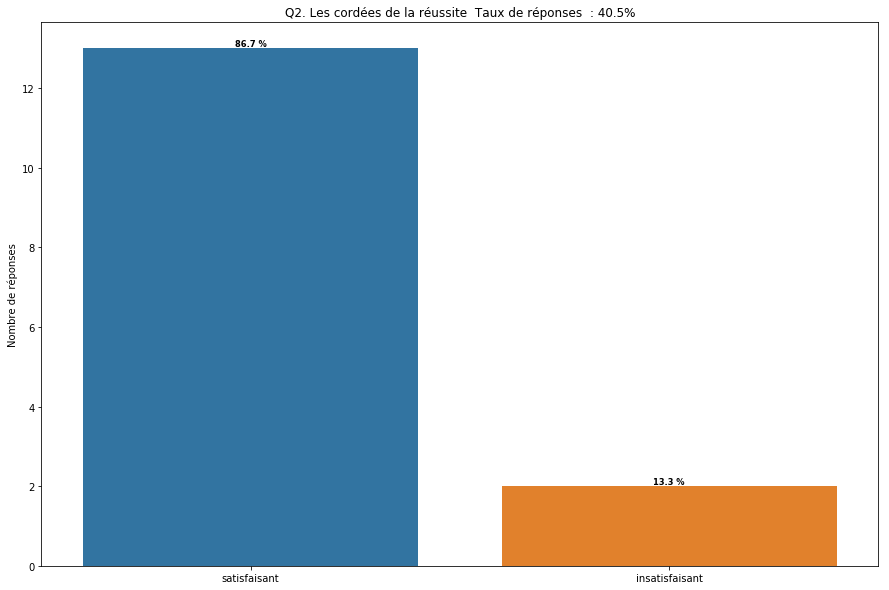

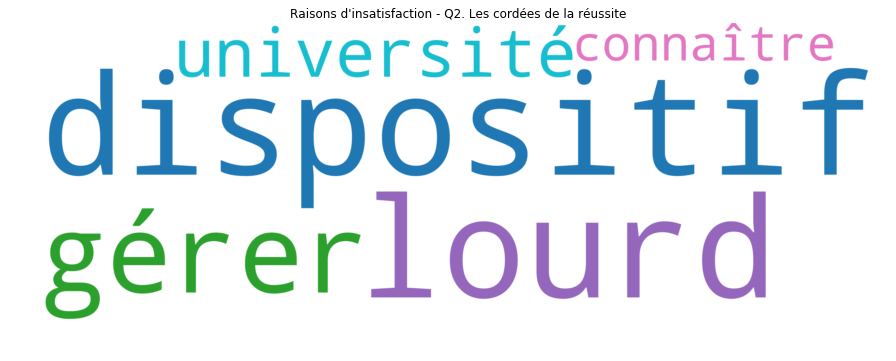

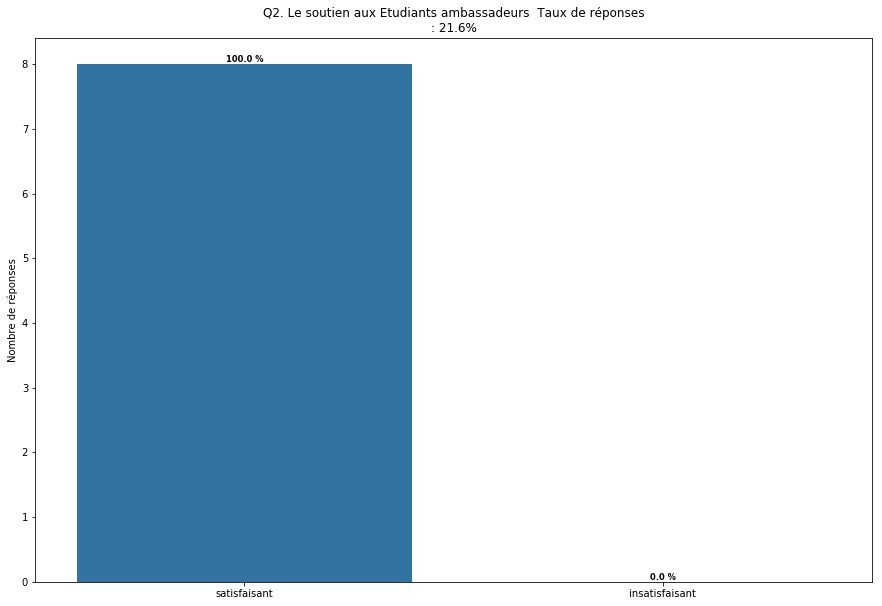

<Figure size 1080x720 with 0 Axes>

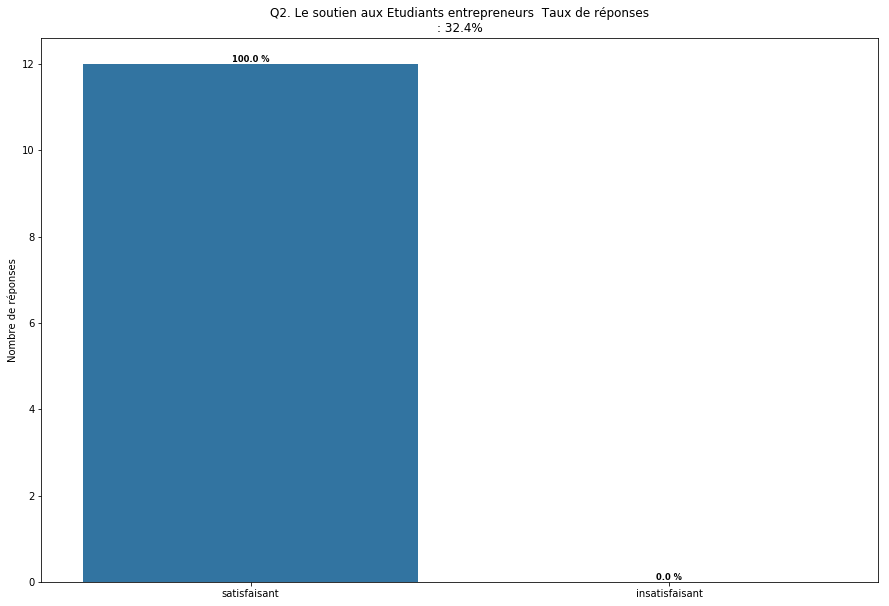

<Figure size 1080x720 with 0 Axes>

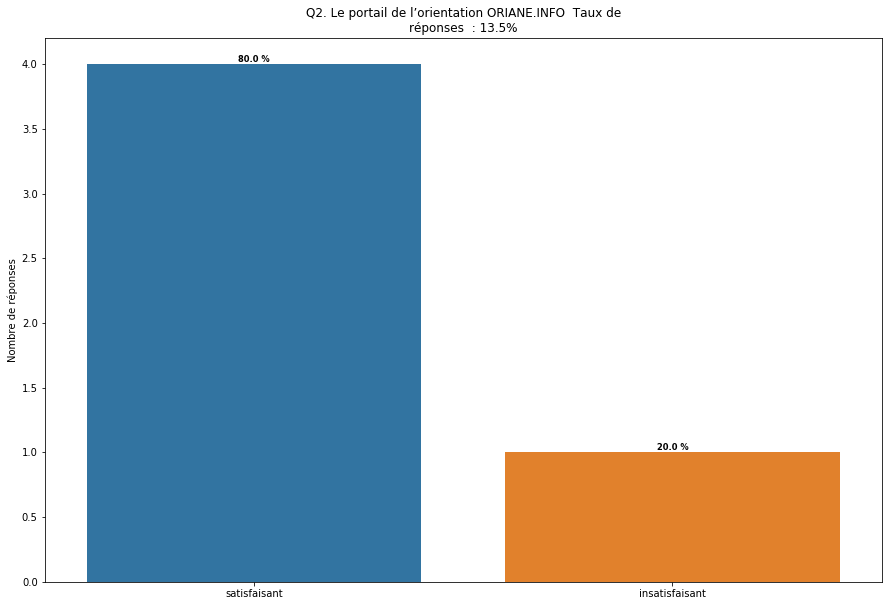

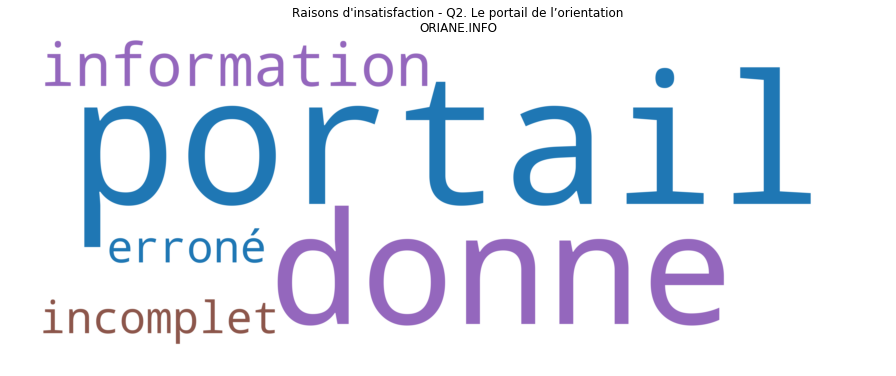

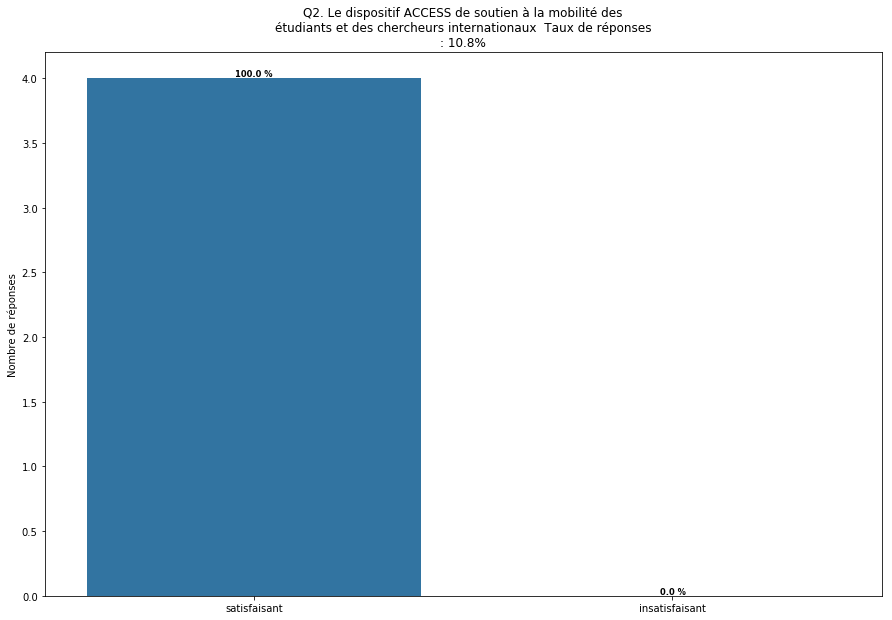

<Figure size 1080x720 with 0 Axes>

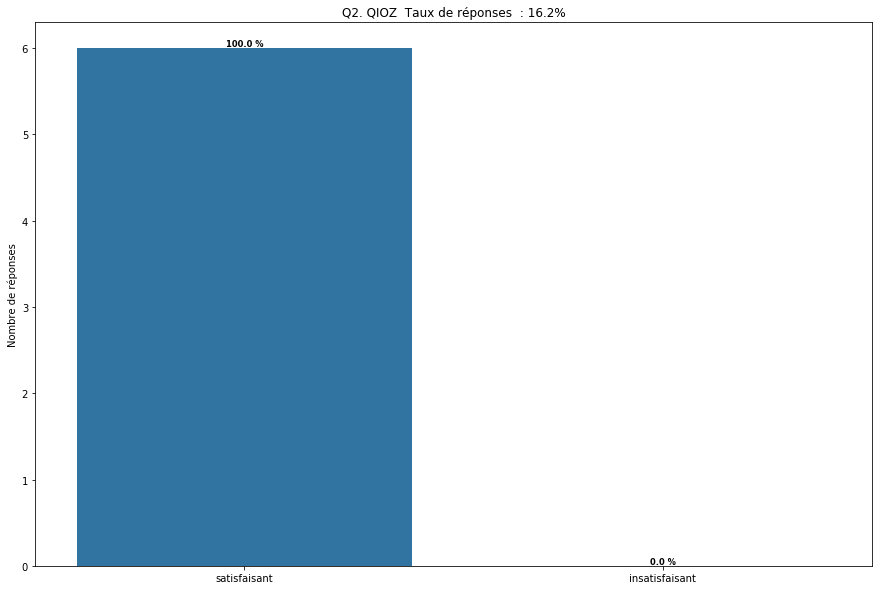

<Figure size 1080x720 with 0 Axes>

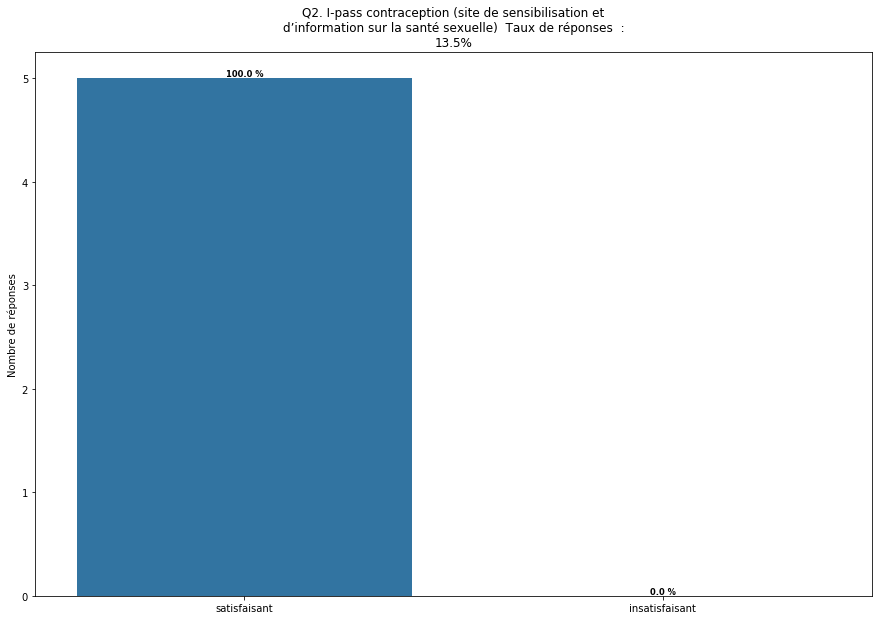

<Figure size 1080x720 with 0 Axes>

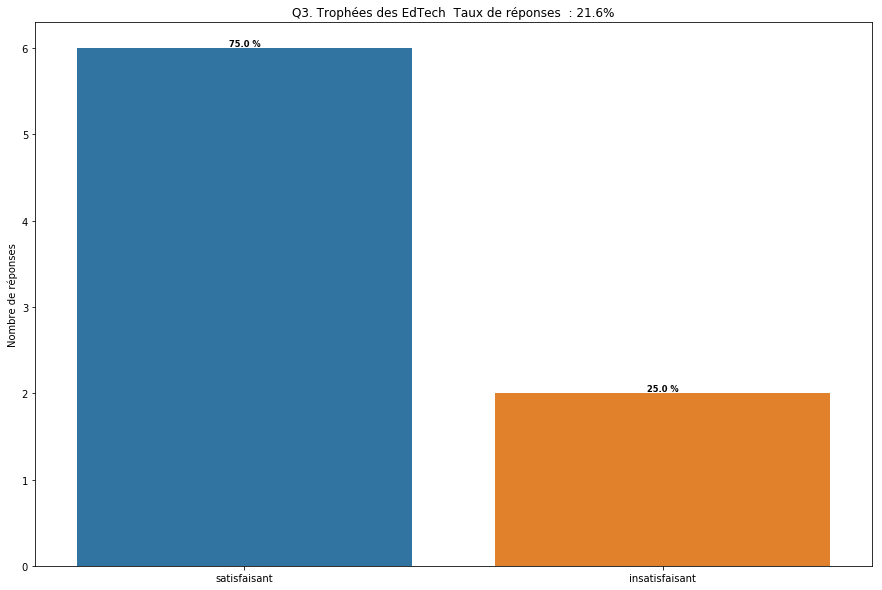

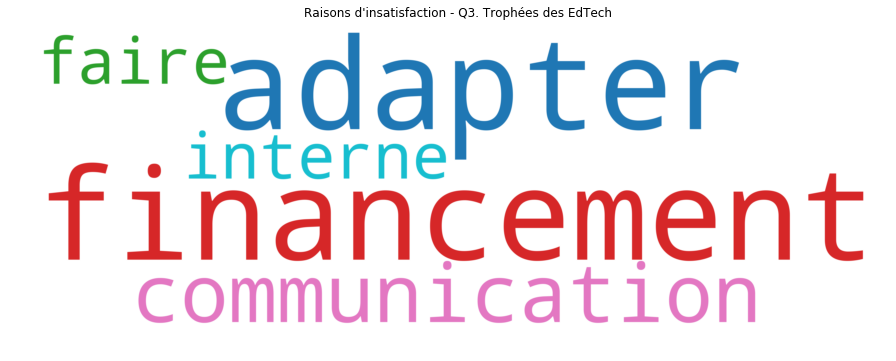

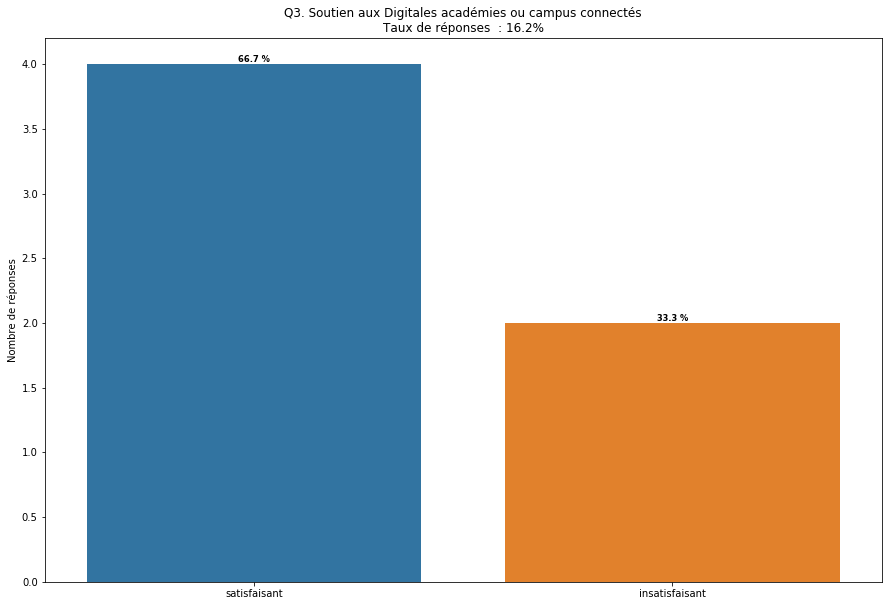

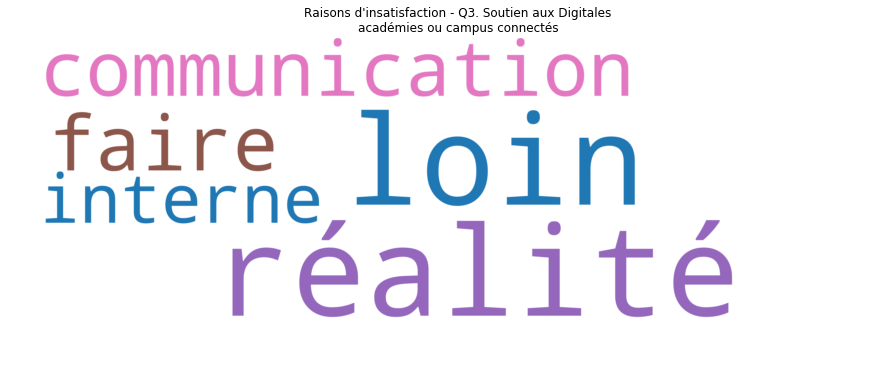

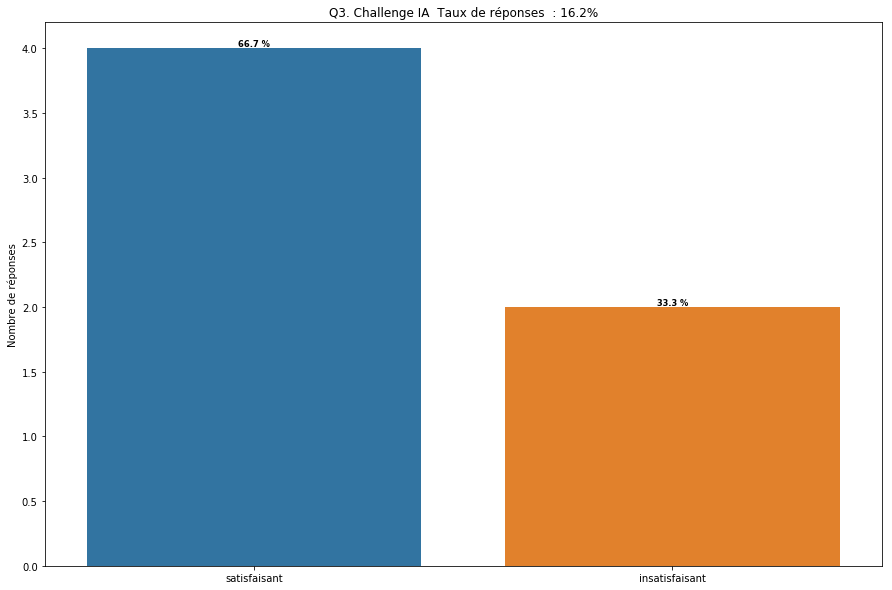

...

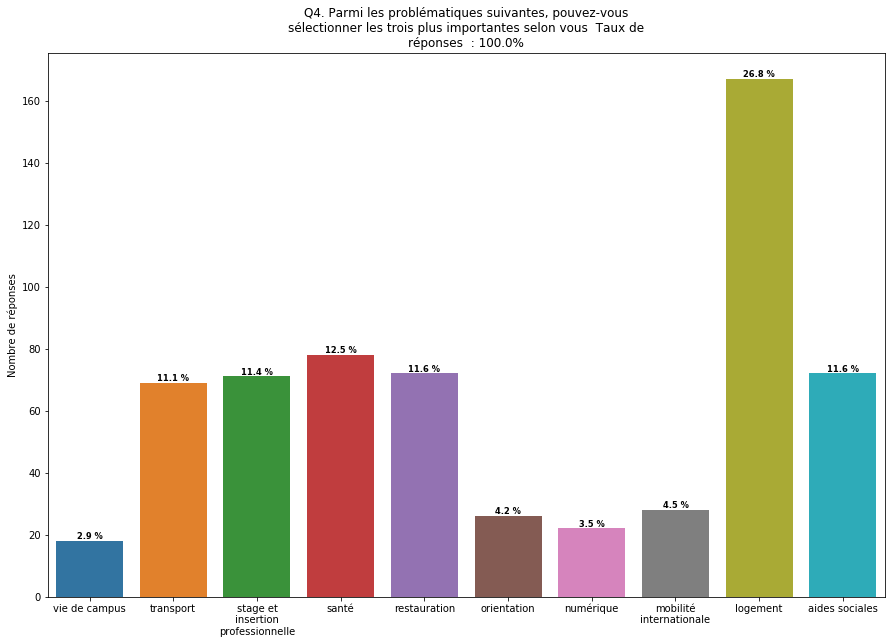

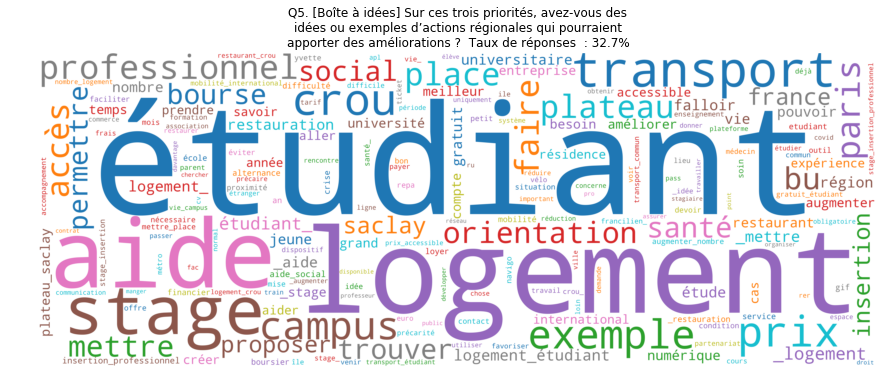

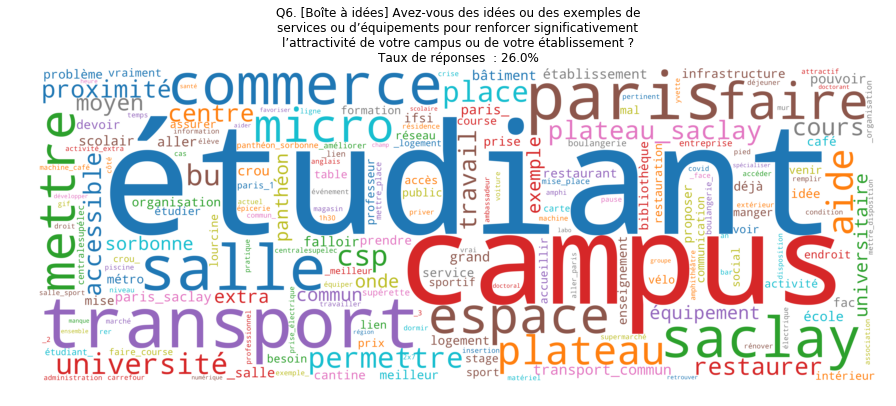

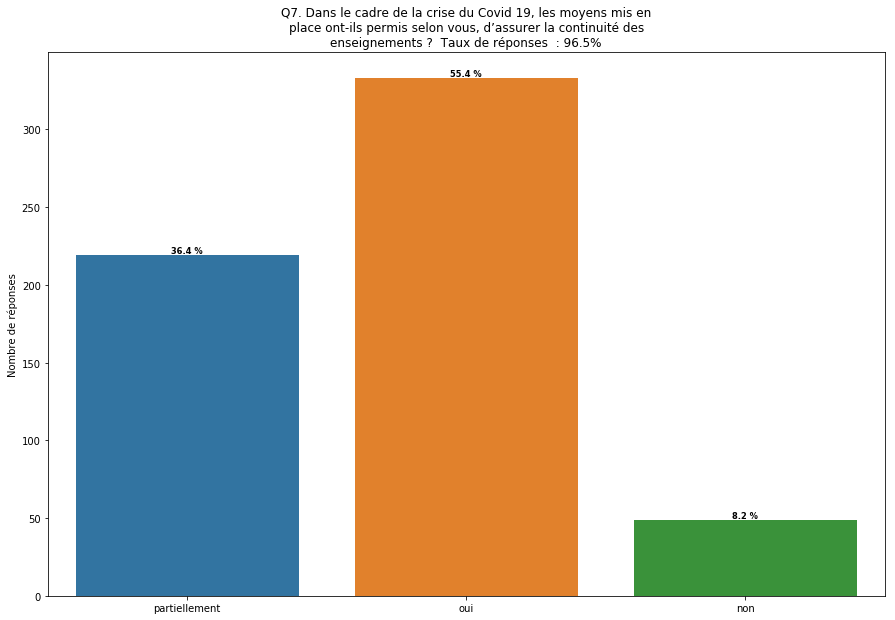

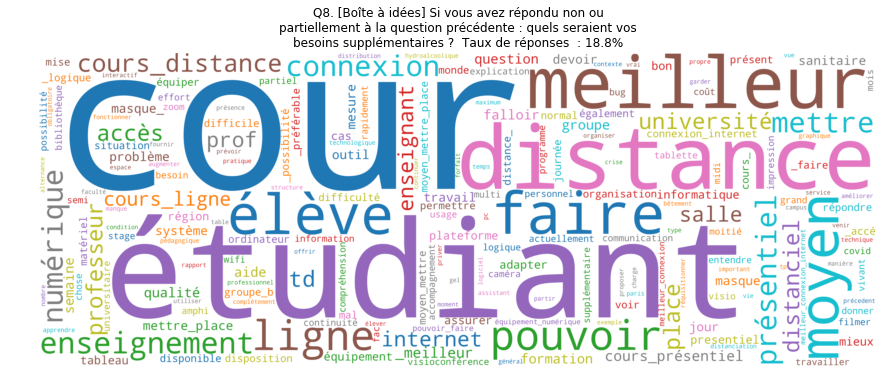

In [116]:
%time plot_main_results(df_list, themes, df_stats)

### Nombres de réponses - histogramme - des réponses auw questions 1 de chaque questionnaire

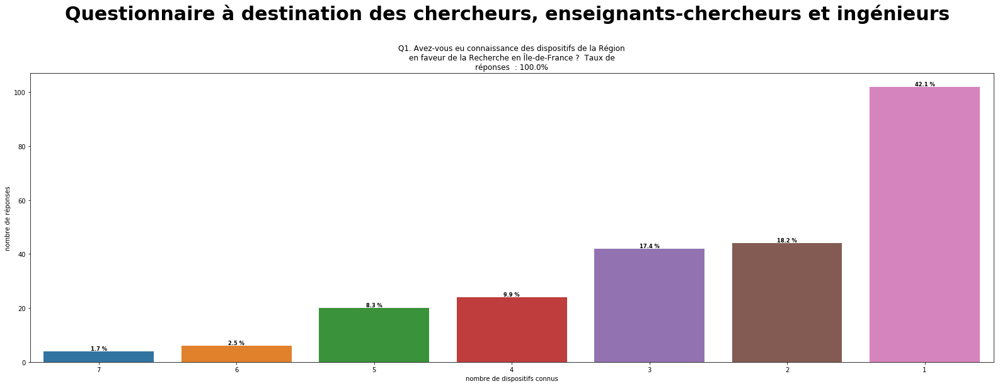

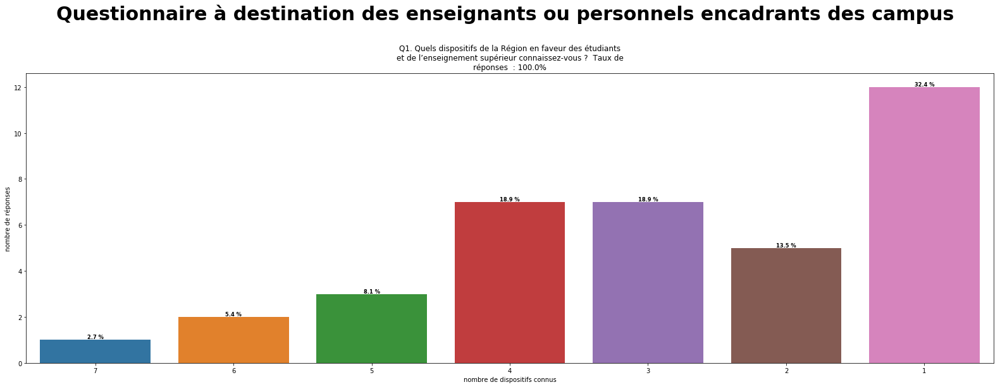

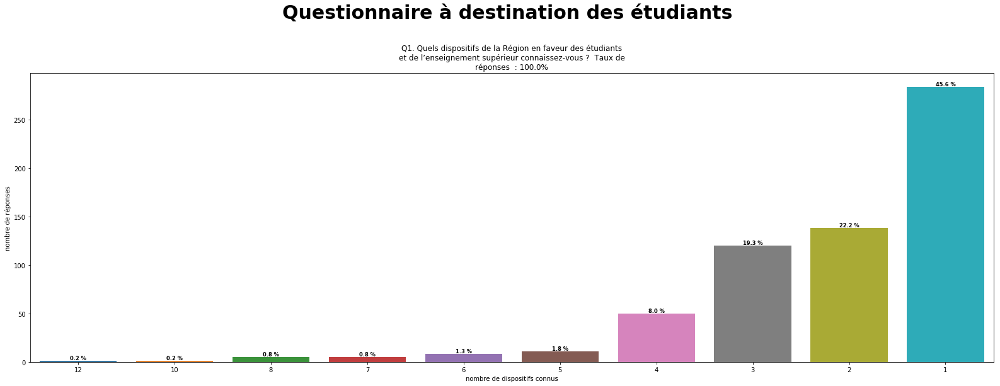

In [84]:
number_plot_main_results_Q1(df_list, themes, df_stats)

### Nuages de mots - nouveaux

#### ajouter des stop_words

In [46]:
df_def_questions['type de la sous question'].unique()

array(['cmq', 'cq', 'oq', 'mixed_tq_insatisfaisant',
       'multi_mixed_cq_autre'], dtype=object)

In [48]:
df_def_open=df_def_questions[df_def_questions['type de la sous question'].isin(['mixed_tq_insatisfaisant', 'oq'])]
df_def_open.reset_index(drop=True, inplace=True)

In [52]:
def add_stop_words(df_def):
    """
    Cette fonction a pour but de 
    
    """
    df_def_copy=df_def.copy()
    for index, row in df_def_copy.iterrows():
        df_def_copy.loc[index, 'new_stop_words'] = input(str(row['numero questionnaire'])+
                                                          '_'+str(row['numéro de la question'])+'_'+
                                                          str(row['sq_titre_viz']))
    return df_def_copy

In [55]:
df_new_def=add_stop_words(df_def_open)

0_Q3_Quel ou quels DIM vous paraissent nécessaire d’ajouter à la liste ?['dim', 'science', 'recherche', 'domaine']
0_Q4_Les DIM-domaines d’intérêt majeur de recherche['domaine', 'projet', 'science', 'dim', 'recherche', 'financer']
0_Q4_SESAME (les équipements pour les laboratoires)
0_Q4_Les Chaires d’excellence internationale Blaise Pascal['chercheur', 'connaître', 'chaire', 'recherche']
0_Q4_Les bourses doctorales Paris Region PhD['connaître', 'bourse', 'doctoral', 'recherche']
0_Q4_SESAME filière PIA['connaître', 'unknown']
0_Q4_Les bourses postdoctorales du programme européen Paris Region fellowship COFUND['connaître', 'bourse', 'dim', 'post']
0_Q4_Le dispositif ACCESS de soutien à la mobilité des étudiants et des chercheurs internationaux['connaître', 'chercheur', 'dispositif', 'étudiant']
0_Q6_[Boîte à idées] Avez-vous des idées sur les évolutions à apporter aux dispositifs d’intervention de la Région en matière de recherche ?['recherche', 'chercheur', 'doctoral', 'dispositif', 'p

In [57]:
df_new_def.to_csv('df_def_stop.csv', index=False)

In [125]:
def add_new_stop_words(df_def):
    df_def_copy=df_def.copy()
    for index, row in df_def_copy.iterrows():           
        
        
        try:
            new_stop=input(str(row['numero questionnaire'])+'_'+str(row['numéro de la question'])+'_'+
                                                          str(row['sq_titre_viz']))
        except:
            pass
        
        try:
            
            last_stop=ast.literal_eval(str(row['new_stop_words']))
            last_stop.extend(ast.literal_eval(new_stop))
        except:
            last_stop=new_stop
        
        df_def_copy.loc[index, 'new_stop_words']=str(last_stop)
    return df_def_copy

In [126]:
df_new_new_def=add_new_stop_words(df_new_def)

0_Q3_Quel ou quels DIM vous paraissent nécessaire d’ajouter à la liste ?['france', 'île']
0_Q4_Les DIM-domaines d’intérêt majeur de recherche['org', 'refpersys', 'dur', 'falloir', 'exemple', 'devoir']
0_Q4_SESAME (les équipements pour les laboratoires)['f2m', 'fr', 'https', 'multi']
0_Q4_Les Chaires d’excellence internationale Blaise Pascal['refpersys', 'http', 'org', 'évident_', 'connaître_']
0_Q4_Les bourses doctorales Paris Region PhD
0_Q4_SESAME filière PIA['co', '_connaître', '_ironie']
0_Q4_Les bourses postdoctorales du programme européen Paris Region fellowship COFUND['falloir', 'doctorale', 'bourse_post']
0_Q4_Le dispositif ACCESS de soutien à la mobilité des étudiants et des chercheurs internationaux['suffisamment']
0_Q6_[Boîte à idées] Avez-vous des idées sur les évolutions à apporter aux dispositifs d’intervention de la Région en matière de recherche ?['mettre', 'permettre', 'faire', 'falloir', 'pouvoir', 'co', 'refpersys']
1_Q2_L’aide à la mobilité internationale
1_Q2_Les d

In [131]:
df_new_exact_def=df_new_new_def.copy()
df_new_exact_def['o_new_stop_words'] = df_new_def['new_stop_words'].copy()

In [136]:
def error_comp(row):
    if row['new_stop_words']=='':
        return row['o_new_stop_words']
    else:
        return row['new_stop_words']

In [137]:
df_new_exact_def['new_stop_words']=df_new_exact_def.apply(lambda row: error_comp(row), axis=1)

In [140]:
df_new_exact_def.drop(columns=['o_new_stop_words'], inplace=True)

In [141]:
df_new_exact_def

,questionnaire,numero questionnaire,numéro de la question,titre de la question,type de la sous question,sous question,sq_titre_viz,new_stop_words
0,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q3,"Voici la liste des différents Domaines d’intérêt majeur de recherche : Math'innov, Matériaux anciens et patrimoniaux (MAP), Science et ingénierie en région Île-de-France pour les technologies quantiques (SIRTEQ), Islam en Île-de-France, Astrophysique et conditions d'apparition de la vie (ACAV+), Ruptures en sciences des solides poreux (Respore), Thérapie génique, Un monde, une seule sa...",oq,"Voici la liste des différents Domaines d’intérêt majeur de recherche : Math'innov, Matériaux anciens et patrimoniaux (MAP), Science et ingénierie en région Île-de-France pour les technologies quantiques (SIRTEQ), Islam en Île-de-France, Astrophysique et conditions d'apparition de la vie (ACAV+), Ruptures en sciences des solides poreux (Respore), Thérapie génique, Un monde, une seule santé (One Health), Empowering Life sCiences with Innovative Technologies – Technologies innovantes pour les s...",Quel ou quels DIM vous paraissent nécessaire d’ajouter à la liste ?,"['dim', 'science', 'recherche', 'domaine', 'france', 'île']"
1,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q4,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,Les DIM-domaines d’intérêt majeur de recherche,Les DIM-domaines d’intérêt majeur de recherche,"['domaine', 'projet', 'science', 'dim', 'recherche', 'financer', 'org', 'refpersys', 'dur', 'falloir', 'exemple', 'devoir']"
2,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q4,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,SESAME (les équipements pour les laboratoires),SESAME (les équipements pour les laboratoires),"['f2m', 'fr', 'https', 'multi']"
3,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q4,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,Les Chaires d’excellence internationale Blaise Pascal,Les Chaires d’excellence internationale Blaise Pascal,"['chercheur', 'connaître', 'chaire', 'recherche', 'refpersys', 'http', 'org', 'évident_', 'connaître_']"
4,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q4,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,Les bourses doctorales Paris Region PhD,Les bourses doctorales Paris Region PhD,"['connaître', 'bourse', 'doctoral', 'recherche']"
5,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q4,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,SESAME filière PIA,SESAME filière PIA,"['connaître', 'unknown', 'co', '_connaître', '_ironie']"
6,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q4,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,Les bourses postdoctorales du programme européen Paris Region fellowship COFUND,Les bourses postdoctorales du programme européen Paris Region fellowship COFUND,"['connaître', 'bourse', 'dim', 'post', 'falloir', 'doctorale', 'bourse_post']"
7,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q4,Comment évaluez-vous le ou les dispositifs que vous connaissez ?,mixed_tq_insatisfaisant,Le dispositif ACCESS de soutien à la mobilité des étudiants et des chercheurs internationaux,Le dispositif ACCESS de soutien à la mobilité des étudiants et des chercheurs internationaux,"['connaître', 'chercheur', 'dispositif', 'étudiant', 'suffisamment']"
8,"Questionnaire à destination des chercheurs, enseignants-chercheurs et ingénieurs",0,Q6,Avez-vous des idées sur les évolutions à apporter aux dispositifs d’intervention de la Région en matière d

#### Fonction générale

In [142]:
def MAIN_new_wordcloud(df_list, themes, df_def):
    
    
    #On sélectionne chaque questionnaire un par un:
    for n_questionnaire in range(len(themes)):
        df_def_temp=df_def[df_def['numero questionnaire']==n_questionnaire].reset_index(drop=True)
        
        for index, row in df_def_temp.iterrows():
                new_wordcloud(df_list, n_questionnaire, row)
    return None

In [145]:
def new_wordcloud(df_list, n_questionnaire, row):
        
    df_temp=df_list[n_questionnaire][row['sous question']].dropna()
    df_temp=df_temp.apply(preprocessing_part)
    text_list=df_temp.to_list()
    text_list=" ".join(text_list).replace('satisfaisant', '')
    text_list=text_list.strip()
    text_list=re.sub(' +',' ',text_list)
    text_list=text_list.split(" ")
    
    text_list_ngram=text_list
    
    n=len(text_list)
    for i in range(n-1):
        text_list_ngram.append(text_list[i]+'_'+text_list[i+1])

    for i in range(n-2):
        text_list_ngram.append(text_list[i]+'_'+text_list[i+1]+'_'+text_list[i+2])
    text_list_ngram=" ".join(text_list_ngram)
    plt.figure(figsize=(15,10))
    
    
    try:
        new_stop= ast.literal_eval(str(row['new_stop_words']))
    except: 
        pass
    #On initialise à nouveau les stop words:
    new_STOPWORDS = spacy.lang.fr.stop_words.STOP_WORDS
    try:
        for n_s in new_stop:
            new_STOPWORDS.add(n_s)
    except:
        pass
    
    new_STOPWORDS.add('satisfaisant')
    new_STOPWORDS.add('satisfaisant_satisfaisant')
    new_STOPWORDS.add('_satisfaisant')
    new_STOPWORDS.add('satisfaisant_satisfaisant_satisfaisant')
    new_STOPWORDS.add('plutôt')
    new_STOPWORDS.add('très')
    
    # Generate word cloud
    try:
        wordcloud = WordCloud(width = 8000, height = 3000, random_state=1, 
                              background_color='white', colormap='tab10', 
                              collocations=False, stopwords = new_STOPWORDS).generate(text_list_ngram)# .generate(" ".join(text_list))


        #mask=idf_mask, contour_width=3, contour_color='steelblue'
        # Plot
        axi = plt.imshow(wordcloud, interpolation='bilinear')
        figtitle="\n".join(wrap(row['numéro de la question'] + '. ' + row['sq_titre_viz'], 60))
        plt.title(figtitle)

        #Changer les axes:
        plt.axis('off')
        axi.get_figure().savefig("nouveaux_nuages/"+
                                 str(n_questionnaire)+"_"+row['numéro de la question']+"_"+row['sq_titre_viz'][:15]+".png")
    except: 
        pass

    return None

#### Application

C:\Users\adrie\AppData\Roaming\Python\Python37\site-packages\matplotlib\pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
C:\Users\adrie\AppData\Roaming\Python\Python37\site-packages\matplotlib\pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


Wall time: 29min 12s


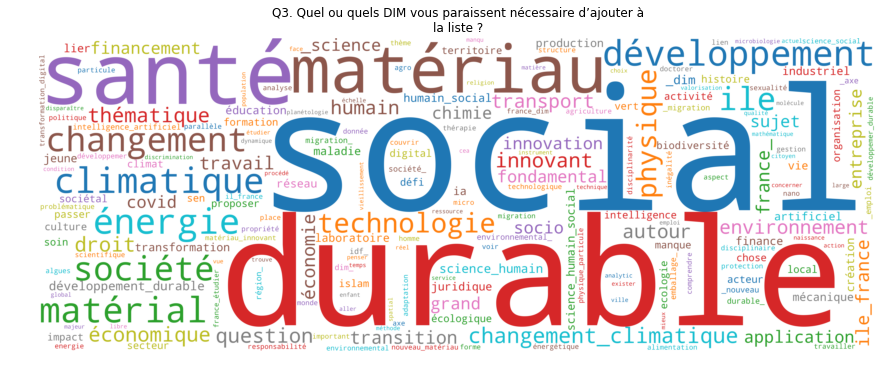

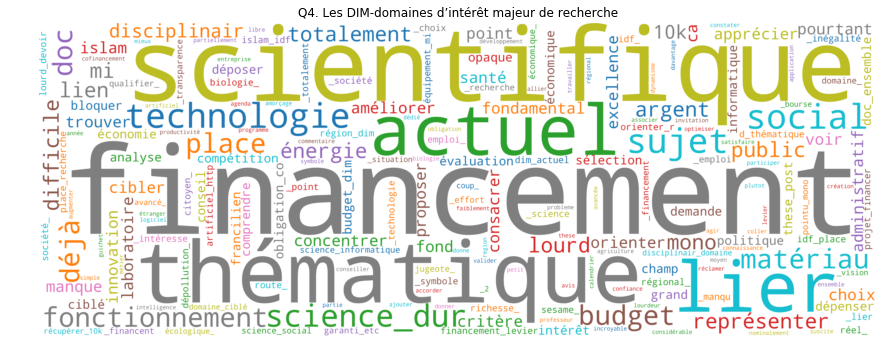

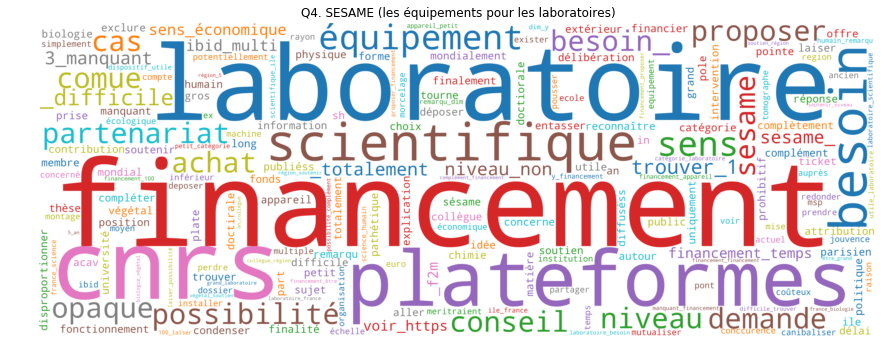

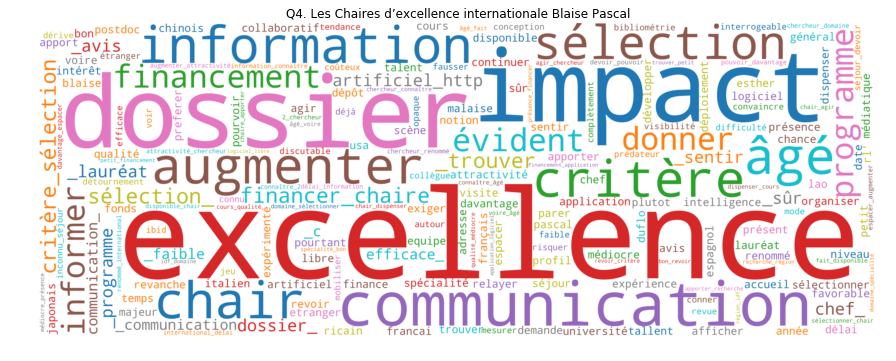

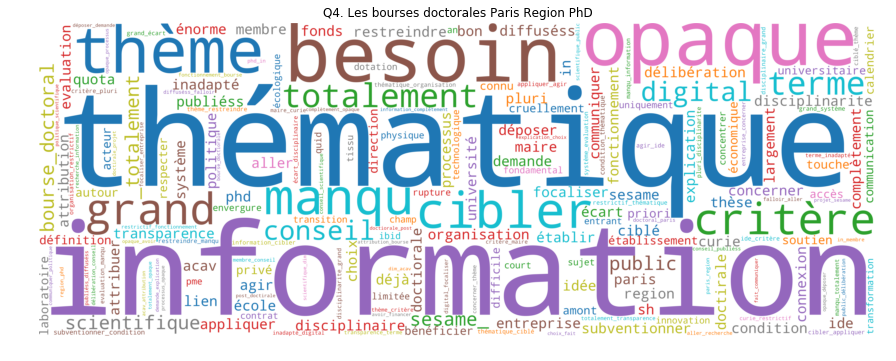

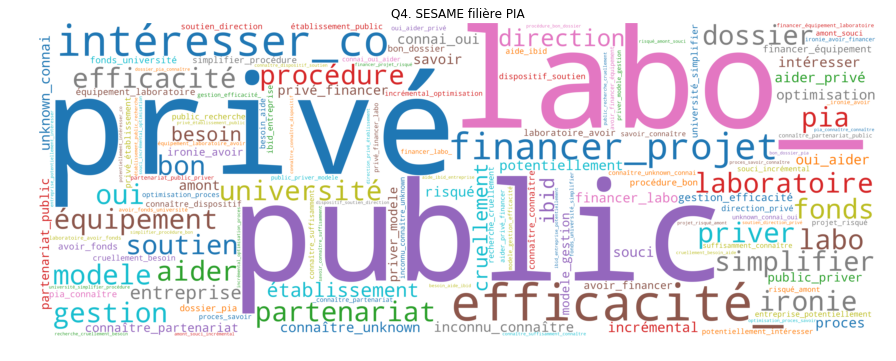

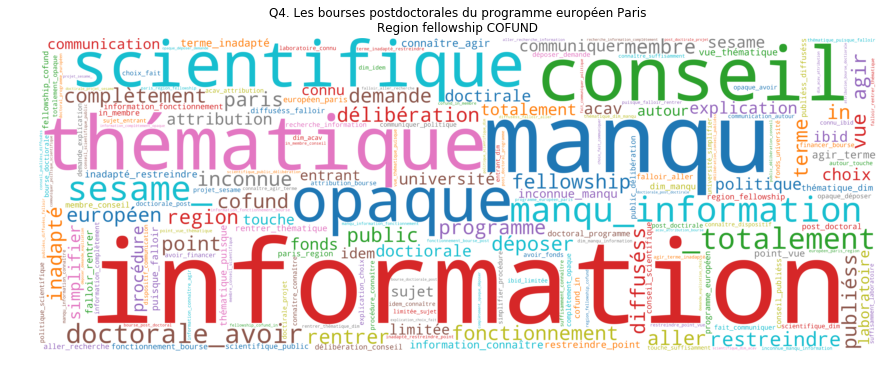

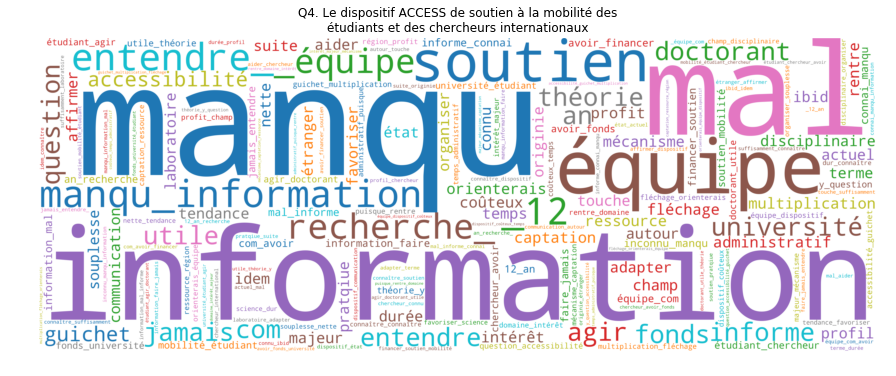

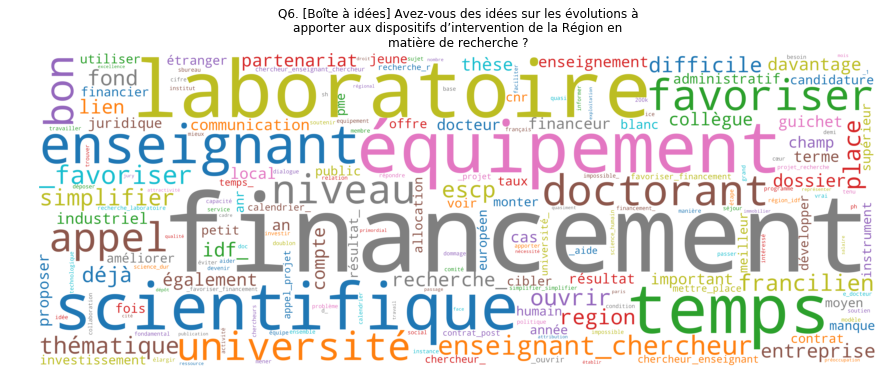

<Figure size 1080x720 with 0 Axes>

<Figure size 1080x720 with 0 Axes>

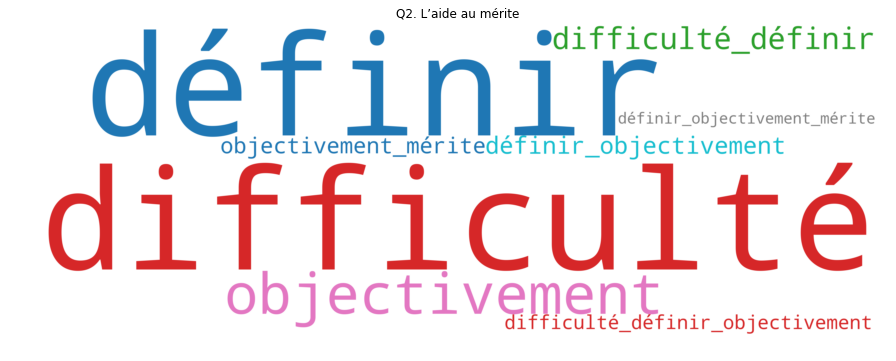

<Figure size 1080x720 with 0 Axes>

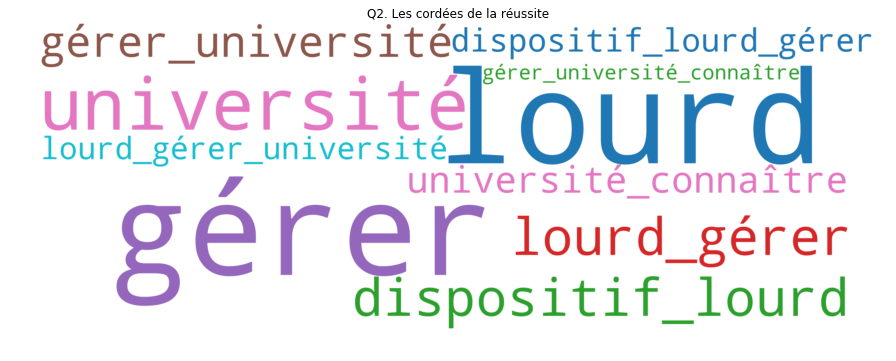

<Figure size 1080x720 with 0 Axes>

<Figure size 1080x720 with 0 Axes>

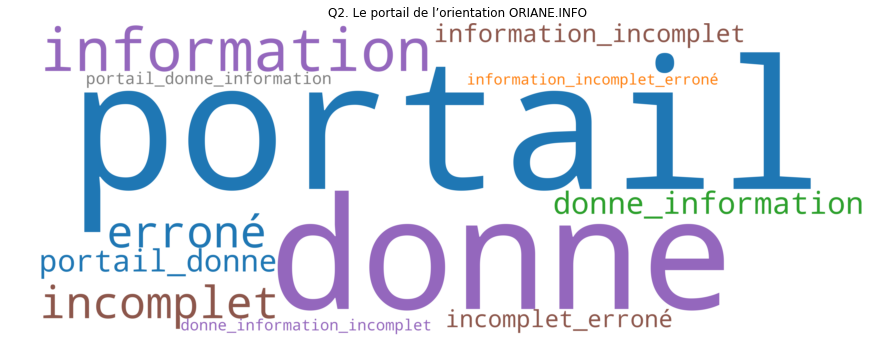

<Figure size 1080x720 with 0 Axes>

<Figure size 1080x720 with 0 Axes>

<Figure size 1080x720 with 0 Axes>

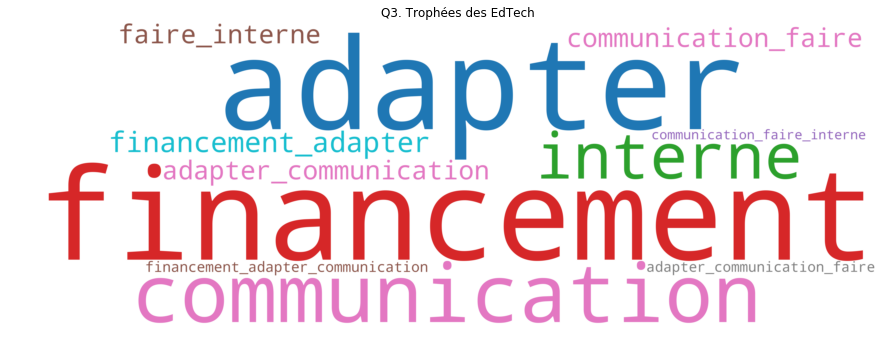

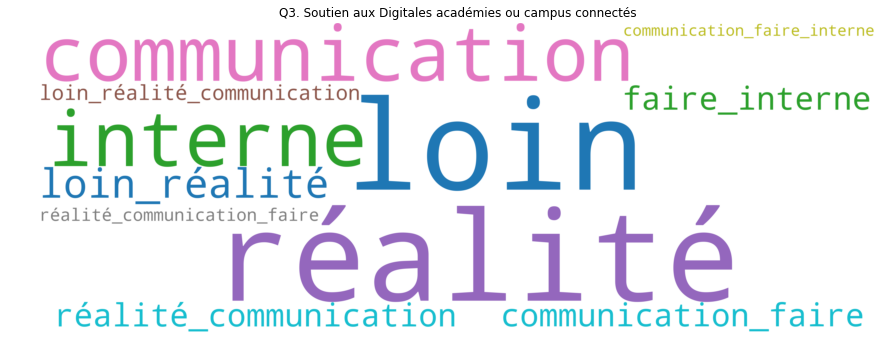

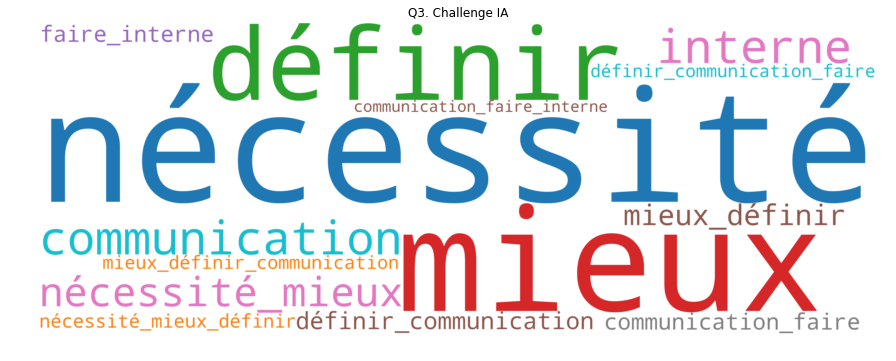

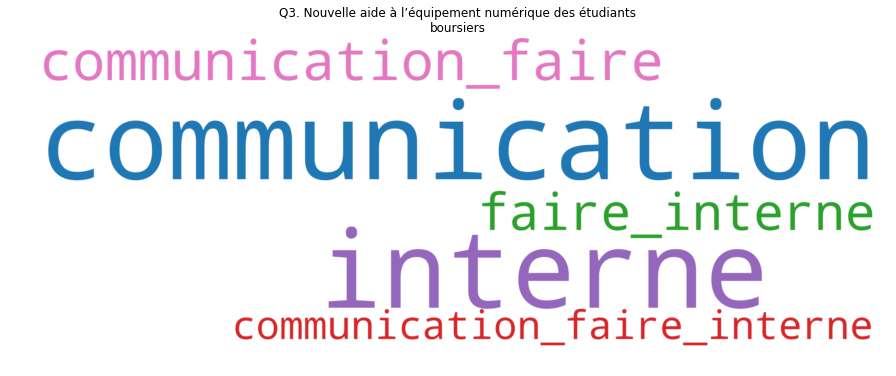

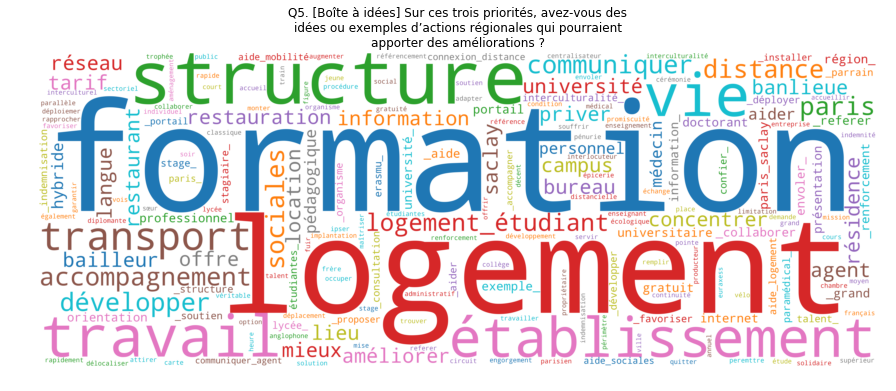

...

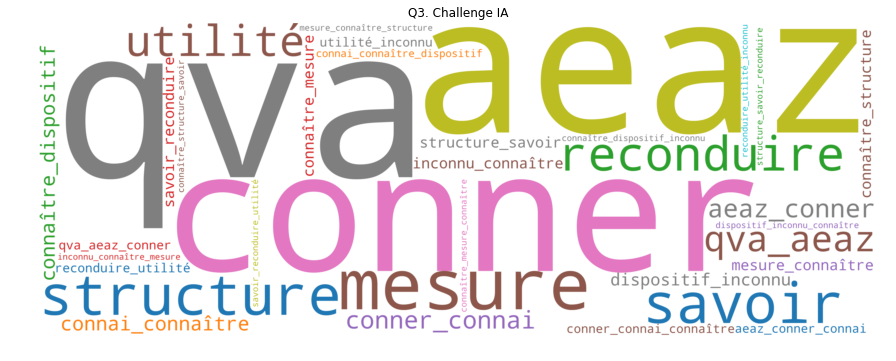

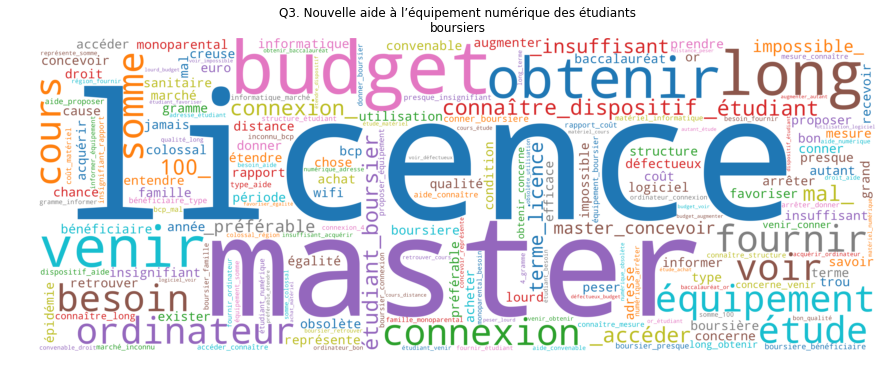

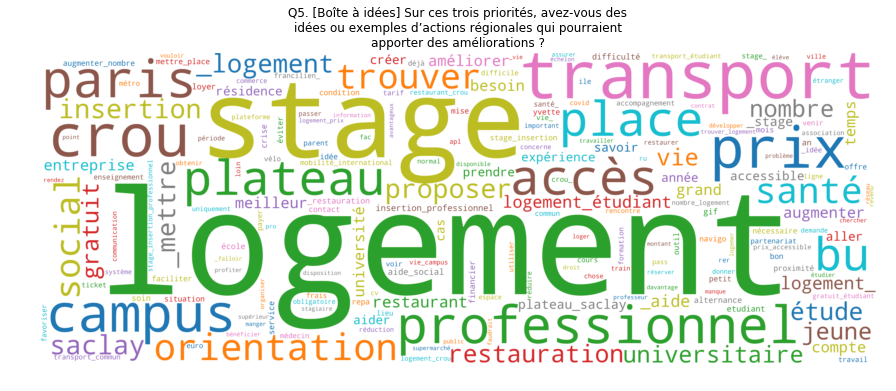

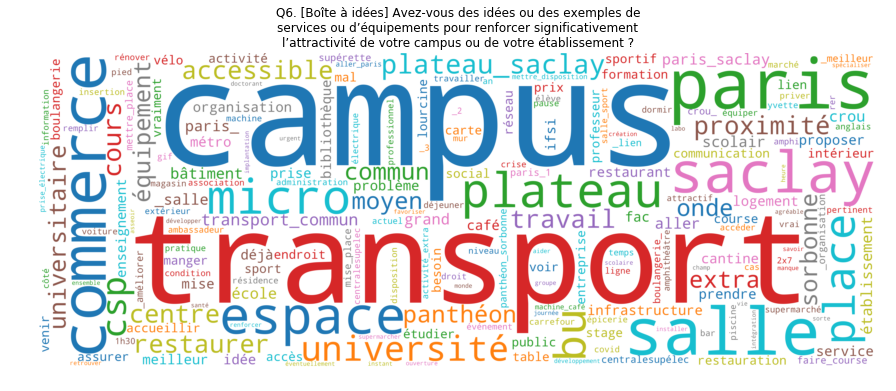

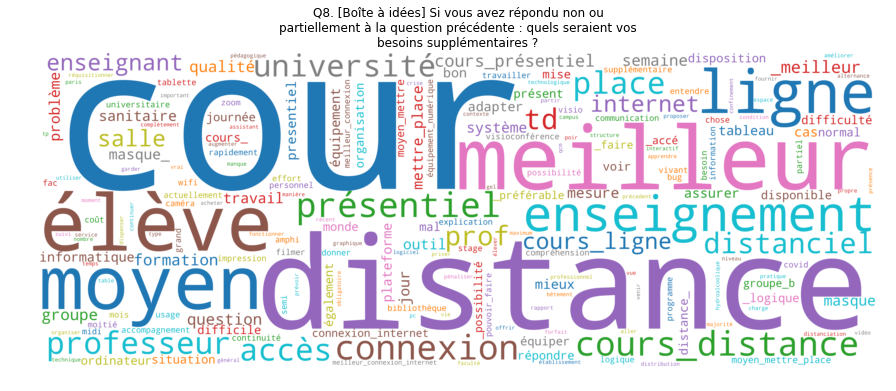

In [146]:
%time MAIN_new_wordcloud(df_list, themes, df_new_exact_def)

## Fonctions utiles:

### Main fonction to plot the results

In [115]:
def plot_main_results(df_list, themes, df_stats):
    """
    Cette fonction a pour but de 
    
    """
    #On sélectionne chaque questionnaire un par un:
    for n_questionnaire in range(len(themes)):
    #for n_questionnaire in range(,1):

        #On selectionne seulement les colonnes du questionnaire considéré:
        df_stats_temp=df_stats[df_stats['numero questionnaire']==n_questionnaire].reset_index(drop=True)
        

        #On compute n, la taille du questionnaire (nombre de colonnes à considérer)
        #n=df_stats_temp.shape[0]
        
        #On ajoute le nombre de questions de type 'insatisfaisant' : 
        #n+=df_stats_temp[df_stats_temp['type de la sous question']=='mixed_tq_insatisfaisant'].shape[0]
        #On définit aussi un décalage d'index pour ce type de questions:
        #i_sup=0

        #On définit le titre principal pour chaque question, i.e. le titre de chaque questionnaire
        #suptitle=themes[n_questionnaire]

        #ncols=2
        #nrows=(n+2)//ncols
        #fig,ax = plt.subplots(nrows, ncols, figsize=(25,6*nrows))
        #fig.tight_layout(pad=15)
        
        #On définit le titre 'principal'
        #fig.suptitle(suptitle, size=30, fontweight='bold')

        # Hide exceeding subplots
        #for i in range(n, ncols*nrows):
        #    ax.flatten()[i].axis('off')


        #On affiche l'histogramme des réponses pour chaque question:    
        for index, row in df_stats_temp.iterrows():
            #plt.sca(ax.flatten()[index+i_sup])

            
            #On compute d'abord le type de la question considérée : 
            type_q=row['type de la sous question']
            #Conditions sur le type de question:
            if type_q=='cq':
                closed_question_unique(df_list, n_questionnaire, row)
            elif type_q=='cmq':
                closed_question_multiple(df_list, n_questionnaire, row)
            elif type_q=='mixed_tq_insatisfaisant':
                mixed_type_questions_insatisfaisant(df_list, n_questionnaire, row)
                #i_sup+=1
                #Maintenant on ajoute les raisons d'insatisfaction:
                #plt.sca(ax.flatten()[index+i_sup])
                raisons_insatisfactions(df_list, n_questionnaire, row)
            elif type_q=='multi_mixed_cq_autre':
                mixed_type_question_autre(df_list, n_questionnaire, row)
            else:
                plot_wordcloud_questions_ouvertes(df_list, n_questionnaire, row)
            
                
        plt.savefig("Rendu_final/Images/"+str(n_questionnaire)+"Main_results.svg")
    return None

### Adding frequencies

In [45]:
# Add frequencies to a countplot
# Source: https://stackoverflow.com/questions/33179122/seaborn-countplot-with-frequencies
def add_frequencies(ax, ncount):    
    for p in ax.patches:
        x=p.get_bbox().get_points()[:,0]
        y=p.get_bbox().get_points()[1,1]
        
        if np.isnan(y):
            y=0
        ax.annotate('{:.1f} %'.format(100.*y/ncount), (x.mean(), y), 
                ha='center', va='bottom', size='small', color='black', weight='bold')

    return None

### Definition of subplots:

#### Questions fermées

##### Questions fermées à choix unique:

In [106]:
def closed_question_unique(df_list, n_questionnaire, row):
    """
    Fonction pour afficher les données pour les questions fermées à choix unique 
    """
    
    plt.figure(figsize=(15,10))
    # Les deux lignes suivantes servent à prédéfinir l'ordre des labels (réponses aux questions) dans l'affichage
    xlabels = df_list[n_questionnaire].loc[:,row['sous question']]
    xlabels = xlabels.value_counts().index.sort_values(ascending=False)


    axi= sns.countplot(x=row['sous question'],
                       data=df_list[n_questionnaire], 
                      order = xlabels)



    # Wrap long questions into lines
    axi.set_title("\n".join(wrap(row['numéro de la question'] + '. ' + row['sq_titre_viz'] 
                                 + '\n Taux de réponses  : {:.1f}%'.format(row['non_nul_rate']), 60)))
    axi.set_xlabel('')
    # We also set a wrap here (for one very long answer...)
    axi.set_xticklabels(["\n".join(wrap(s, 17)) for s in xlabels])
    axi.set_ylabel('Nombre de réponses')
    
    #axi.text(0, -7, "Taux de réponses : {:.1f}%".format(row['non_nul_rate']), size=15, ha="center")
    
    add_frequencies(axi, row['n_n_null'])
    axi.get_figure().savefig("Rendu_final/Images/"+str(n_questionnaire)+"/"+row['numéro de la question']+"_"+row['sq_titre_viz'][:15]+".svg")
    
    return None

##### Questions fermées à choix multiple :

In [107]:
def closed_question_multiple(df_list, n_questionnaire, row):
    #Ligne changeant pour ce type de question:
    df_temp=pd.DataFrame()
    df_temp[row['sous question']]=df_list[n_questionnaire][row['sous question']].apply(lambda x: x.split(';'))
    df_temp[row['sous question']] = df_temp.explode(row['sous question']).reset_index(drop=True)
    #On remplace les réponses trop longues:
    df_temp[row['sous question']] = df_temp.replace({row['sous question'] : dict_replace})

    plt.figure(figsize=(15,10))
    # Les deux lignes suivantes servent à prédéfinir l'ordre des labels (réponses aux questions) dans l'affichage
    xlabels = df_temp[row['sous question']]
    xlabels = xlabels.value_counts().index.sort_values(ascending=False)

    axi= sns.countplot(x=row['sous question'],
                       data=df_temp, order = xlabels)



    # Wrap long questions into lines
    axi.set_title("\n".join(wrap(row['numéro de la question'] + '. ' + row['sq_titre_viz']
                                 + '\n Taux de réponses  : {:.1f}%'.format(row['non_nul_rate']), 60)))
    axi.set_xlabel('')
    # We also set a wrap here (for one very long answer...)
    axi.set_xticklabels(["\n".join(wrap(s, 17)) for s in xlabels])
    axi.set_ylabel('Nombre de réponses')
    
    
    #On ajoute une légende donnant le taux de réponses en dessous:
    #axi.text(0, -7, "Taux de réponses : {:.1f}%".format(row['non_nul_rate']), size=15, ha="center")
    
    
    add_frequencies(axi, row['n_n_null'])
    axi.get_figure().savefig("Rendu_final/Images/"+str(n_questionnaire)+"/"+row['numéro de la question']+"_"+row['sq_titre_viz'][:15]+".svg")
    
    return None

In [53]:
dict_replace={'Les DIM-domaines d’intérêt majeur de recherche (13 réseaux thématiques de laboratoires pour lesquels la Région finance des emplois scientifiques et des équipements sur appels à projets en leur sein)' : 'DIM',
             "SESAME (dispositif de financement d’équipements mi-lourds pour les laboratoires)" : "SESAME",
             "Les Chaires d’excellence internationale Blaise Pascal (appels à projets visant à permettre l’accueil de talents étrangers dans les établissements franciliens)" : "Chaires BP", 
             "Les bourses doctorales Paris Region PhD (financement de thèses visant à répondre aux besoins des PME en matière de transformation digitale)" : "PRPhD",
             "SESAME filière PIA (dispositif de financement de plateformes partenariales laboratoire-entreprise)" : "SESAME filière PIA",
             "Les bourses doctorales du programme européen Paris Region fellowship COFUND (nouvel appel à projet visant à financer des post-doctorants internationaux dans le cadre H2020 et faire venir les meilleurs jeunes chercheurs en IDF)" : "COFUND",
             "Le dispositif ACCESS de soutien à la mobilité des chercheurs et des étudiants internationaux (dispositif mis en œuvre par la CIUP pour faciliter les démarches et l’accueil en IDF)" : "ACCESS",
             
             "L’aide à la mobilité internationale (financement de bourses de mobilité à l’étranger pour les étudiants de tous niveaux) ":"Aide à la mobilité internationale",
             "L’aide à la mobilité internationale (financement de bourses de mobilité à l’étranger pour les étudiants de tous niveaux)":"Aide à la mobilité internationale",
            "Les dispositifs de lutte contre la précarité des étudiants (aides alimentaires d’urgence, aides pour l’équipement numérique…)":"Les dispositifs de lutte contre la précarité des étudiants",
             "L’aide au mérite (financement d’une bourse aux bacheliers méritants pour accompagner le démarrage de leurs études)" : "aide au mérite",
             "Le soutien au diplôme d’accès aux études universitaires (DAEU – dispositif de financement des reprises d’études pour ceux qui n’ont pas eu le baccalauréat)" : "DAEU",
             "Les cordées de la réussite (dispositif visant à favoriser l’émergence de parcours d’excellence dans l’enseignement supérieur pour tous les lycéens)":"Les cordées de la réussite",
             "Le soutien aux Etudiants ambassadeurs (financement d’une aide spécifique aux étudiants en mobilité qui portent haut l’image de l’écosystème francilien d’ESRI)":"Le soutien aux Etudiants ambassadeurs",
             "Le soutien aux Etudiants entrepreneurs (PEPITE START’UP – dispositif d’aides directe et indirecte aux étudiants entrepreneurs, notamment leur accueil à Station F)":"PEPITE START’UP",
             "Le portail de l’orientation ORIANE.INFO (portail d’information sur les métiers, les parcours et les formations en IDF)":"Le portail de l’orientation ORIANE.INFO",
             "Le dispositif ACCESS de soutien à la mobilité des étudiants et des chercheurs internationaux (dispositif mis en œuvre par la CIUP pour faciliter les démarches et l’accueil en IDF)":"ACCESS",
             "QIOZ (la plateforme gratuite d’apprentissage des langues mise en place par la Région)":"QIOZ",
             "I-pass contraception (site de sensibilisation et d’information sur la santé sexuelle)":"I-pass contraception"}

##### Nombre de dispositifs connus pour les Q1

In [108]:
def number_answers_closed_question_multiple(df_list, n_questionnaire, row):
    #Ligne changeant pour ce type de question:
    df_temp=pd.DataFrame()
    df_temp[row['sous question']]=df_list[n_questionnaire][row['sous question']].apply(lambda x: x.split(';'))
    df_temp['nombre de dispositifs connus'] = df_temp[row['sous question']].apply(lambda x: len(x))
    plt.figure(figsize=(15,10))
    # Les deux lignes suivantes servent à prédéfinir l'ordre des labels (réponses aux questions) dans l'affichage
    xlabels = df_temp['nombre de dispositifs connus']
    xlabels = xlabels.value_counts().index.sort_values(ascending=False)

    axi= sns.countplot(x='nombre de dispositifs connus',
                       data=df_temp, order = xlabels)



    # Wrap long questions into lines
    axi.set_title("\n".join(wrap(row['numéro de la question'] + '. ' + row['sq_titre_viz']
                                 + '\n Taux de réponses  : {:.1f}%'.format(row['non_nul_rate']), 60)))
    #axi.set_xlabel('')
    # We also set a wrap here (for one very long answer...)
    #axi.set_xticklabels(["\n".join(wrap(s, 17)) for s in xlabels])
    axi.set_ylabel('nombre de réponses')
    #axi.text(0, -7, "Taux de réponses : {:.1f}%".format(row['non_nul_rate']), size=15, ha="center")
    add_frequencies(axi, row['n_n_null'])
    
    axi.get_figure().savefig("Rendu_final/Images/"+str(n_questionnaire)+"_Nb_dispositifs_connus.svg")
    
    return None

In [55]:
def number_plot_main_results_Q1(df_list, themes, df_stats):
    """
    Cette fonction a pour but de 
    
    """
    df_stats_copy=df_stats[df_stats['numéro de la question']=='Q1'].copy()
    #On sélectionne chaque questionnaire un par un:
    for n_questionnaire in range(len(themes)):
        #On selectionne seulement les colonnes du questionnaire considéré:
        df_stats_temp=df_stats_copy[df_stats_copy['numero questionnaire']==n_questionnaire].reset_index(drop=True)
        
        #On compute n, la taille du questionnaire (nombre de colonnes à considérer)
        n=df_stats_temp.shape[0]

        #On définit le titre principal pour chaque question, i.e. le titre de chaque questionnaire
        suptitle=themes[n_questionnaire]

        ncols=1
        nrows=1
        fig,ax = plt.subplots(nrows, ncols, figsize=(25,10*nrows))
        fig.tight_layout(pad=12)
        
        #On définit le titre 'principal'
        fig.suptitle(suptitle, size=30, fontweight='bold')

        # Hide exceeding subplots
        for i in range(n, ncols*nrows):
            ax.flatten()[i].axis('off')


        #On affiche l'histogramme des réponses pour chaque question:    
        for index, row in df_stats_temp.iterrows():
            number_answers_closed_question_multiple(df_list, n_questionnaire, row)
            
        

    return None

#### Questions de type mixte

##### Insatisfaisant

In [109]:
def mixed_type_questions_insatisfaisant(df_list, n_questionnaire, row):


    #Ligne changeant pour ce type de question:

    valeurs_autorisees =['plutôt satisfaisant', 'très satisfaisant', np.nan]

    df_temp=pd.DataFrame()
    df_temp[row['sous question']]=df_list[n_questionnaire][row['sous question']]        
    
    df_temp.loc[~df_temp[row['sous question']].isin(valeurs_autorisees),row['sous question']]='insatisfaisant'
    dict_replace_insatisfaisant={'plutôt satisfaisant':'satisfaisant', 'très satisfaisant':'satisfaisant'}
    df_temp=df_temp.replace({row['sous question'] : dict_replace_insatisfaisant})
    df_temp.dropna(inplace=True)
    df_temp=df_temp.reset_index(drop=True)


    plt.figure(figsize=(15,10))
    # Les deux lignes suivantes servent à prédéfinir l'ordre des labels (réponses aux questions) dans l'affichage
    xlabels = ['satisfaisant', 'insatisfaisant'] #df_temp[row['sous question']]
    #xlabels = xlabels.value_counts().index.sort_values(ascending=False)

    if df_temp[row['sous question']].to_list()!=[]:        
        axi= sns.countplot(x=row['sous question'],
                           data=df_temp, order = xlabels)



        # Wrap long questions into lines
        axi.set_title("\n".join(wrap(row['numéro de la question'] + '. ' + row['sq_titre_viz']
                                     + '\n Taux de réponses  : {:.1f}%'.format(row['non_nul_rate']), 60)))
        axi.set_xlabel('')
        # We also set a wrap here (for one very long answer...)
        axi.set_xticklabels(["\n".join(wrap(s, 17)) for s in xlabels])
        axi.set_ylabel('Nombre de réponses')
        #axi.text(0, -7, "Taux de réponses : {:.1f}%".format(row['non_nul_rate']), size=15, ha="center")
        add_frequencies(axi, row['n_n_null'])
        axi.get_figure().savefig("Rendu_final/Images/"+str(n_questionnaire)+"/"+row['numéro de la question']+"_"+row['sq_titre_viz'][:15]+".svg")
    
    return None

##### Raisons d'insatisfaction

In [63]:
def plot_raisons_insatisfactions(df_list, themes, df_stats):
    """
    Cette fonction a pour but de 
    
    """
    #On sélectionne chaque questionnaire un par un:
    for n_questionnaire in range(len(themes)):
        
        
        #On selectionne seulement les colonnes du questionnaire considéré:
        df_stats_temp=df_stats[df_stats['numero questionnaire']==n_questionnaire].reset_index(drop=True)
        

        #On compute n, la taille du questionnaire (nombre de colonnes à considérer)
        n=df_stats_temp.shape[0]

        #On définit le titre principal pour chaque question, i.e. le titre de chaque questionnaire
        suptitle=themes[n_questionnaire]

        ncols=2
        nrows=(n+2)//ncols
        fig,ax = plt.subplots(nrows, ncols, figsize=(25,6*nrows))
        fig.tight_layout(pad=15)
        
        #On définit le titre 'principal'
        #fig.suptitle(suptitle, size=30, fontweight='bold')

        # Hide exceeding subplots
        for i in range(n, ncols*nrows):
            ax.flatten()[i].axis('off')


        #On affiche l'histogramme des réponses pour chaque question:    
        for index, row in df_stats_temp.iterrows():
            plt.sca(ax.flatten()[index])

            
            #On compute d'abord le type de la question considérée : 
            type_q=row['type de la sous question']
            #Conditions sur le type de question:

            if type_q=='mixed_tq_insatisfaisant':
                raisons_insatisfactions(df_list, n_questionnaire, row)

    return None

In [62]:
STOPWORDS.add('satisfaisant')

In [110]:
def raisons_insatisfactions(df_list, n_questionnaire, row):


    #Ligne changeant pour ce type de question:

    df_temp=df_list[n_questionnaire][row['sous question']].dropna()
    df_temp=df_temp.apply(preprocessing_part)
    text_list=df_temp.to_list()
    
    
    
    try:
        plt.figure(figsize=(15,10))
        # Generate word cloud
        wordcloud = WordCloud(width = 8000, height = 3000, random_state=1, 
                              background_color='white', colormap='tab10', 
                              collocations=False, stopwords = STOPWORDS).generate(" ".join(text_list))


        #mask=idf_mask, contour_width=3, contour_color='steelblue'
        # Plot
        axi = plt.imshow(wordcloud, interpolation='bilinear')
        figtitle="\n".join(wrap("Raisons d'insatisfaction - " + row['numéro de la question'] + '. ' + row['sq_titre_viz'], 60))

        plt.title(figtitle)

        #Changer les axes:
        plt.axis('off')
        axi.get_figure().savefig("Rendu_final/Images/"+str(n_questionnaire)+"/"+row['numéro de la question']+"_RAISONS_"+row['sq_titre_viz'][:15]+".svg")
        return None
    except:
        return None

##### Autre

In [111]:
def mixed_type_question_autre(df_list, n_questionnaire, row):

    #Ligne changeant pour ce type de question:

    valeurs_autorisees =['Un manque d’informations adaptées',
                        'Un interlocuteur difficile à identifier',
                        'Une réticence à engager une collaboration public/privé',
                        'Des lourdeurs administratives ou juridiques',
                        'Un manque de temps''Un manque d’informations adaptées',
                        'Un interlocuteur difficile à identifier',
                        'Une réticence à engager une collaboration public/privé',
                        'Des lourdeurs administratives ou juridiques',
                        'Un manque de temps', np.nan]

    df_temp=pd.DataFrame()

    df_temp[row['sous question']]=df_list[n_questionnaire][row['sous question']].astype(str).apply(lambda x: x.split(';'))
    df_temp[row['sous question']] = df_temp.explode(row['sous question']).reset_index(drop=True)      

    
    df_temp.loc[~df_temp[row['sous question']].isin(valeurs_autorisees),row['sous question']]='Autre'
    df_temp.dropna(inplace=True)
    df_temp=df_temp.reset_index(drop=True)


    plt.figure(figsize=(15,10))
    # Les deux lignes suivantes servent à prédéfinir l'ordre des labels (réponses aux questions) dans l'affichage
    xlabels = df_temp[row['sous question']]
    xlabels = xlabels.value_counts().index.sort_values(ascending=False)

    if xlabels.to_list()!=[]:        
        axi= sns.countplot(x=row['sous question'],
                           data=df_temp, order = xlabels)



        # Wrap long questions into lines
        axi.set_title("\n".join(wrap(row['numéro de la question'] + '. ' + row['sq_titre_viz']
                                     + '\n Taux de réponses  : {:.1f}%'.format(row['non_nul_rate']), 60)))
        axi.set_xlabel('')
        # We also set a wrap here (for one very long answer...)
        axi.set_xticklabels(["\n".join(wrap(s, 17)) for s in xlabels])
        axi.set_ylabel('Nombre de réponses')
        #axi.text(0, -7, "Taux de réponses : {:.1f}%".format(row['non_nul_rate']), size=15, ha="center")
        add_frequencies(axi, row['n_n_null'])
        axi.get_figure().savefig("Rendu_final/Images/"+str(n_questionnaire)+"/"+row['numéro de la question']+"_"+row['sq_titre_viz'][:15]+".svg")
    

#### questions ouvertes 

Type : `oq`

In [63]:
def normalize(text):
    # some issues in normalise package
    try:
        return ' '.join(normalise(text,tokenizer=word_tokenize,verbose=False))
    except:
        return text
def remove_punct(doc):
    return [t for t in doc if t.text not in string.punctuation]
def remove_stop_words(doc):
    return [t for t in doc if not t.is_stop]
def lemmatize(doc):
    return ' '.join([t.lemma_ for t in doc])
    
def preprocessing_part(text):
    normalized_text=normalize(text).lower()
    doc=spacy_nlp(normalized_text)
    removed_punct=remove_punct(doc)
    removed_stop_words=remove_stop_words(removed_punct)
    return lemmatize(removed_stop_words)

In [ ]:
#d = path.dirname(__file__) if "__file__" in locals() else os.getcwd()
#idf_mask = np.array(Image.open(path.join(d, "carte_idf.png")))

In [113]:
def plot_wordcloud_questions_ouvertes(df_list, n_questionnaire, row):
    #https://stackoverflow.com/questions/9662995/matplotlib-change-title-and-colorbar-text-and-tick-colors
    
    df_temp=df_list[n_questionnaire][row['sous question']].dropna()
    df_temp=df_temp.apply(preprocessing_part)
    text_list=df_temp.to_list()
    text_list=" ".join(text_list)
    text_list=text_list.split(" ")
    
    text_list_ngram=text_list
    
    n=len(text_list)
    for i in range(n-1):
        text_list_ngram.append(text_list[i]+'_'+text_list[i+1])

    for i in range(n-2):
        text_list_ngram.append(text_list[i]+'_'+text_list[i+1]+'_'+text_list[i+2])
    text_list_ngram=" ".join(text_list_ngram)
    
    
    plt.figure(figsize=(15,10))
    
    # Generate word cloud
    wordcloud = WordCloud(width = 8000, height = 3000, random_state=1, 
                          background_color='white', colormap='tab10', 
                          collocations=False, stopwords = STOPWORDS).generate(text_list_ngram)# .generate(" ".join(text_list))
    
    
    #mask=idf_mask, contour_width=3, contour_color='steelblue'
    # Plot
    axi = plt.imshow(wordcloud, interpolation='bilinear')
    figtitle="\n".join(wrap(row['numéro de la question'] + '. ' + row['sq_titre_viz']
                            + '\n Taux de réponses  : {:.1f}%'.format(row['non_nul_rate']), 60))
    
    plt.title(figtitle)
    
    #Changer les axes:
    plt.axis('off')
    axi.get_figure().savefig("Rendu_final/Images/"+str(n_questionnaire)+"/"+row['numéro de la question']+"_"+row['sq_titre_viz'][:15]+".svg")
    

    return None

In [ ]:
doc=spacy_nlp('je suis beau')
#' '.join(normalise('je suis beau',tokenizer=word_tokenize,verbose=False))

In [ ]:
'_'.join([t.lemma_ for t in doc])

In [ ]:
def bigram(text):
    l=''
    doc=spacy_nlp(text)
    for i in range(len(doc)-1):
        a=str(doc[i])+'_'+str(doc[i+1])
        l=l +' '+a
    return l

In [ ]:
bigram('je suis beau')

In [ ]:
doc[0]+doc[1]

In [ ]:
l='je suis '
l+' '.join('je')

## DRAFT

### Taux de satisfaction moyen: 

Chercheurs: 

In [117]:
np.mean([68.4,82.3,73.3,63.8,68,73,65.5])

70.61428571428571

Enseignants:

In [118]:
np.mean([100,100,91.7,100,80,100,100,86.7,100,100,66.7,88.9,66.7,75])

89.69285714285715

Etudiants:

In [119]:
np.mean([88.9,92.4,88.2,89.9,87,92.6,91,90.9,84.6,89.7,88.8,83.2,89.1,82.8])

88.50714285714285

Global

In [120]:
np.mean([68.4,82.3,73.3,63.8,68,73,65.5, 88.9,92.4,88.2,89.9,87,92.6,91,90.9,84.6,89.7,88.8,83.2,89.1,82.8,100,100,91.7,100,80,100,100,86.7,100,100,66.7,88.9,66.7,75])

85.40285714285714

In [ ]:
pip install flair

In [ ]:
import flair

In [ ]:
flair_sentiment = flair.models.TextClassifier.load('fr-sentiment')

In [ ]:


s = flair.data.Sentence(sentence)
flair_sentiment.predict(s)
total_sentiment = s.labels
total_sentiment

In [ ]:
df_stats[df_stats['type de la sous question']=='oq']